# import

In [18]:
import sqlite3
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
%matplotlib inline
plt.style.use('ggplot')
import warnings
warnings.filterwarnings('ignore')
import matplotlib
import missingno as msno
import pickle
from sklearn.preprocessing import OneHotEncoder
from datetime import datetime, date
from xgboost import XGBClassifier
from numpy.core._exceptions import UFuncTypeError
from pandas.tseries.holiday import USFederalHolidayCalendar as calendar

from scipy.spatial import distance_matrix,distance
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (18,8)

In [19]:
run_in_colab = False
if 'google.colab' in str(get_ipython()):
    run_in_colab = True
    print('Running on CoLab')
else:
    print('Running locally on Jupyter')


Running on CoLab


# Get the Data

In [20]:
# Mount drive in google colab
if run_in_colab:
    from google.colab import drive
    drive.mount('/content/drive/')
else:  # Set local path 
    data_path = "C:/Users/User/Desktop/university/year_C_semester_A/stat_lab/"  

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [21]:
# loading the fires data directly with pickle
with open('/content/drive/MyDrive/APLDS/fires.pickle', 'rb') as f:
     df = pickle.load(f)

# Globals

OneHotEncoder

In [22]:
  ohe = OneHotEncoder(categories='auto', handle_unknown='ignore')

"has" features

In [23]:
good_has_features = []
good_has_features_list = ['FIRE_NAME','FIRE_CODE']

categorial features

In [24]:
categorial_features = ['SOURCE_SYSTEM_TYPE', 'SOURCE_SYSTEM', 'NWCG_REPORTING_AGENCY',
       'NWCG_REPORTING_UNIT_NAME', 'SOURCE_REPORTING_UNIT',
       'SOURCE_REPORTING_UNIT_NAME',
'OWNER_DESCR', 'STATE', 'FIPS_NAME']

Categorial features to represent as one-hot

In [25]:
one_hot_features = []
one_hot_features_list = ['STATE','SOURCE_SYSTEM', 'NWCG_REPORTING_AGENCY', 'NWCG_REPORTING_UNIT_NAME','OWNER_DESCR']

List of irrelevant features

In [26]:
features_to_delete = []
features_to_delete_list = ["FOD_ID", "FPA_ID", "OBJECTID", "LOCAL_FIRE_REPORT_ID", 
                           "LOCAL_INCIDENT_ID", "ICS_209_INCIDENT_NUMBER", "ICS_209_NAME", "MTBS_ID", 'NWCG_REPORTING_UNIT_ID', 
                            'FIRE_SIZE_CLASS', "OWNER_CODE", 'COMPLEX_NAME', 'FIPS_CODE', 
                           'COUNTY', 'Shape', 'SOURCE_SYSTEM_TYPE', 'CONT_DOY', 'DISCOVERY_DOY', "MTBS_FIRE_NAME"]

In [27]:
cause_one_hot = None

In [28]:
save_load_train_df = False

# File name constants

In [29]:
drive_project_dir = '/content/drive/MyDrive/APLDS/'

df_train_pickle_fn = 'df_train_raw.pickle'
df_train_pickle_path_raw = drive_project_dir + df_train_pickle_fn

df_test_pickle_fn = 'df_test_raw.pickle'
df_test_pickle_path = drive_project_dir + df_test_pickle_fn

# Split Data and sample

In [30]:
from sklearn.model_selection import train_test_split
df_train, df_test = train_test_split(df, test_size=0.2, random_state=25)
df_train.to_pickle(df_train_pickle_path_raw)
df_test.to_pickle(df_test_pickle_path)

In [31]:
df_train.head(2)

,OBJECTID,FOD_ID,FPA_ID,SOURCE_SYSTEM_TYPE,SOURCE_SYSTEM,NWCG_REPORTING_AGENCY,NWCG_REPORTING_UNIT_ID,NWCG_REPORTING_UNIT_NAME,SOURCE_REPORTING_UNIT,SOURCE_REPORTING_UNIT_NAME,LOCAL_FIRE_REPORT_ID,LOCAL_INCIDENT_ID,FIRE_CODE,FIRE_NAME,ICS_209_INCIDENT_NUMBER,ICS_209_NAME,MTBS_ID,MTBS_FIRE_NAME,COMPLEX_NAME,FIRE_YEAR,DISCOVERY_DATE,DISCOVERY_DOY,DISCOVERY_TIME,STAT_CAUSE_CODE,STAT_CAUSE_DESCR,CONT_DATE,CONT_DOY,CONT_TIME,FIRE_SIZE,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,OWNER_CODE,OWNER_DESCR,STATE,COUNTY,FIPS_CODE,FIPS_NAME,Shape
1126924,1126925,1373524,CDF_1992_55_2221_832,NONFED,ST-CACDF,ST/C&L,USCABDU,San Bernardino Unit,CABDU,CDF - San Bernardino Unit,None,832,None,PROBE,None,None,None,None,None,1992,2448948.5,327,None,2.0,Equipment Use,NaN,NaN,None,0.1,A,34.23000,-117.426111,14.0,MISSING/NOT SPECIFIED,CA,None,None,None,b'\x00\x01\xad\x10\x00\x00`z\x88gE[]\xc0H\n\xd...
591012,591013,637629,SFO-SD01660303-3763,NONFED,ST-NASF,ST/C&L,USSDSDS,South Dakota Wildland Fire Suppression,SDSDS,South Dakota Wildland Fire Suppression (GPC Area),None,None,None,None,None,None,None,None,None,2003,2452854.5,215,None,1.0,Lightning,NaN,NaN,None,30.0,C,45.63549,-102.101900,14.0,MISSING/NOT SPECIFIED,SD,None,None,None,b'\x00\x01\xad\x10\x00\x00\\\x9a\x9e\x87\x85\x...


In [32]:
sample_df = df_train.sample(100000)

In [33]:
# create dict to map STAT_CAUSE_CODE to STAT_CAUSE_DESCR
to_dict = df[['STAT_CAUSE_DESCR','STAT_CAUSE_CODE']].groupby(['STAT_CAUSE_DESCR','STAT_CAUSE_CODE']).sum().reset_index()
code_to_cause_dict = dict(zip(to_dict['STAT_CAUSE_CODE'].astype(int),to_dict['STAT_CAUSE_DESCR']))

In [34]:
df_train.columns

Index(['OBJECTID', 'FOD_ID', 'FPA_ID', 'SOURCE_SYSTEM_TYPE', 'SOURCE_SYSTEM',
       'NWCG_REPORTING_AGENCY', 'NWCG_REPORTING_UNIT_ID',
       'NWCG_REPORTING_UNIT_NAME', 'SOURCE_REPORTING_UNIT',
       'SOURCE_REPORTING_UNIT_NAME', 'LOCAL_FIRE_REPORT_ID',
       'LOCAL_INCIDENT_ID', 'FIRE_CODE', 'FIRE_NAME',
       'ICS_209_INCIDENT_NUMBER', 'ICS_209_NAME', 'MTBS_ID', 'MTBS_FIRE_NAME',
       'COMPLEX_NAME', 'FIRE_YEAR', 'DISCOVERY_DATE', 'DISCOVERY_DOY',
       'DISCOVERY_TIME', 'STAT_CAUSE_CODE', 'STAT_CAUSE_DESCR', 'CONT_DATE',
       'CONT_DOY', 'CONT_TIME', 'FIRE_SIZE', 'FIRE_SIZE_CLASS', 'LATITUDE',
       'LONGITUDE', 'OWNER_CODE', 'OWNER_DESCR', 'STATE', 'COUNTY',
       'FIPS_CODE', 'FIPS_NAME', 'Shape'],
      dtype='object')

# Cleaning and Visualization 

## Functions

basic information about categorial features

In [35]:
def print_categorial_info(df, feature):
  """
  Print basic information for categorial feature
  """
  print(f"name:{feature}, cardinality:{len(df[feature].unique())}, precent of null values:{df[feature].isna().sum() / df.shape[0]}")

Clean the data

In [36]:
def clean_data(df,features_to_delete):
  return df.drop(columns=features_to_delete, errors='ignore')

Function to calculate precent of nulls is a feature

In [37]:
def print_null_precent(df, feature_name):
  print(f"Precent of nulls out of total {feature_name}: {df[feature_name].isna().sum() / df.shape[0]}")

A function to plot result vs feature

In [38]:
matplotlib.rcParams['figure.figsize'] = (40,18)

def feature_compare_to_cause(sample, column_name, response_name, max_y=1):
  if max_y  is None:
    print("The scale of the y axis is different between each graph.")
  unique_response_values = sample[response_name].unique()
  unique_response_values.sort()
  fig, axs = plt.subplots(ncols=7, nrows=2)
  vals = sample[column_name].unique()
  for i, unique_value in enumerate(unique_response_values):
    curr = sample[sample[response_name] == unique_value][column_name].value_counts(normalize=True).reset_index()
    plot_count = sns.barplot(x='index', y=column_name, data=curr, ax = axs[0 if i < 7 else 1][i % 7], order=vals)
    plot_count.set(xticklabels=vals)
    plot_count.axes.set_title(f"{code_to_cause_dict[int(unique_value)]} fire count by\n {column_name}",fontsize=15)
    if max_y is None:
      plot_count.axes.set(ylim=(0, max_y))
    plot_count.axes.set(ylabel="percent")
  plt.tight_layout()

In [39]:
def plot_cause_along(sample, column_name, response_name):
  print("The scale of the y axis is different between each graph.")
  unique_response_values = sample[response_name].unique()
  unique_response_values.sort()
  fig, axs = plt.subplots(ncols=7, nrows=2)
  for i, unique_value in enumerate(unique_response_values):
    curr = sample[sample[response_name] == unique_value]
    plot_count = sns.countplot(curr[column_name].sort_index(), ax = axs[0 if i < 7 else 1][i % 7])
    plot_count.set(xticklabels=[])
    plot_count.axes.set_title(f"{column_name} count by response name {unique_value}",fontsize=10)

A function to check if two feature represent the exact same

In [40]:
def represent_same_values(data_frame ,name1, name2):
  dict_values = {}

  for index, row in data_frame.iterrows():
    if str(row[name1]) == 'nan':
      continue
    if row[name1] in dict_values:
      if dict_values[row[name1]] != row[name2]:
        print(f"Expected: {dict_values[row[name1]]}, got: {row[name2]} for value: {row[name1]}")
        return False
    else:
      dict_values[row[name1]] = row[name2]
  return True

Check if two features are null together

In [41]:
def are_null_together(df, feature_1, feature_2):
  return (df[feature_1].isna() != df[feature_2].isna()).sum() == 0

Check if a feature is a unique identifier

In [42]:
def is_unique_identifier(df, feature_name):
  not_null = df.dropna(subset=[feature_name])
  return len(not_null[feature_name].unique()) == not_null.shape[0]

A function to Redoce cardinality of given column

return the columns with the categories that captured {threshold}% of the data, and puts 'other' in the rest.

In [43]:
from collections import Counter
def cumulatively_categorise(column,threshold=0.75,return_categories_list=True,other_name='Other'):
  #Find the threshold value using the percentage and number of instances in the column
  threshold_value=int(threshold*len(column))
  #Initialise an empty list for our new minimised categories
  categories_list=[]
  #Initialise a variable to calculate the sum of frequencies
  s=0
  #Create a counter dictionary of the form unique_value: frequency
  counts=Counter(column)

  #Loop through the category name and its corresponding frequency after sorting the categories by descending order of frequency
  for i,j in counts.most_common():
    #Add the frequency to the global sum
    s+=dict(counts)[i]
    #Append the category name to the list
    categories_list.append(i)
    #Check if the global sum has reached the threshold value, if so break the loop
    if s>=threshold_value:
      break
  #Append the category Other to the list
  categories_list.append(other_name)

  #Replace all instances not in our new categories by Other  
  new_column=column.apply(lambda x: x if x in categories_list else other_name)

  #Return transformed column and unique values if return_categories=True
  if(return_categories_list):
    return new_column,categories_list
  #Return only the transformed column if return_categories=False
  else:
    return new_column

In [44]:
def reducing_cardinality_correlation(df, column_name, results_one_hot=None, thershold=0.75, should_replace=False, one_hot_features=None):
  new_col, categories_list = cumulatively_categorise(df[column_name], thershold, other_name=f'Other_{column_name}')

  if not should_replace:
    output_dummies = pd.get_dummies(new_col)
    print(f"We got {len(categories_list)} dummies for the coulmn")

    #drawing correletiom map for the dummies and the results as dummies
    check_corr = pd.concat([results_one_hot.sort_index(), output_dummies.sort_index()], axis=1)
    corr = check_corr.corr()
    f, ax = plt.subplots(figsize=(30, 30))
    sns.heatmap(corr,annot=True, cmap=sns.diverging_palette(220, 10, as_cmap=True),
                square=True, fmt='.2g', ax=ax)




  if should_replace and one_hot_features:
    one_hot_features.append(column_name)
    df[column_name] = new_col

In [45]:
def plot_cardinality_over_size(column, name):
  values = np.arange(0.01,1,0.05)
  number_values = []

  for value in values:
    new_columm, categories_list = cumulatively_categorise(column, value, other_name=f'Other_{column}')
    number_values.append(len(categories_list))
  
  values = values * 100
  plt.plot(number_values, list(values), marker='o', linestyle='--', color='r', label='Square') 
  plt.xlabel('x')
  plt.ylabel('y') 
  plt.title(f"Reducing cardinality affect for {name}")
  plt.legend() 
  plt.show()

### convert to date_time

In [46]:
def fix_julian_date(df, col):
    """
    converts dates from Julian format (float) to datetime
    col - name of the column to convert
    """
    df[col + '_JULIAN'] = df[col]
    epoch = pd.to_datetime(0, unit='s').to_julian_date()
    disc_dates = df[col]
    df[col] = pd.to_datetime(disc_dates - epoch, unit='D')

In [47]:
def adding_dates_data(df, features_to_delete):
  try:
    fix_julian_date(df, 'DISCOVERY_DATE')
    fix_julian_date(df, 'CONT_DATE')
  except UFuncTypeError as e:
    print('dates allready converted')

  df['DISCOVERY_WOY'] = df['DISCOVERY_DATE'].dt.week
  df['CONT_WOY'] = df['CONT_DATE'].dt.week
  df['DISCOVERY_MONTH'] = df['DISCOVERY_DATE'].dt.month
  df['CONT_MONTH'] = df['CONT_DATE'].dt.month
  try:
    df['CONT_TIME'] = df['CONT_TIME'].apply(lambda x: pd.to_datetime(x, format='%H%M').time() if x else None)
    df['DISCOVERY_TIME'] = df['DISCOVERY_TIME'].apply(lambda x: pd.to_datetime(x, format='%H%M').time() if x else None)
  except ValueError as e:
    print('conversion of CONT_TIME and/or DISCOVERY_TIME - failed')


  features_to_delete.append('CONT_DOY')
  features_to_delete.append('DISCOVERY_DOY')
  
  return df

## Remove irrelevant columns

Removing irrelevant ID columns - FOD_ID, FPA_ID

In [48]:
features_to_delete.append("FOD_ID")
features_to_delete.append("FPA_ID")

Check if OBJECTID is a unique identifier

In [49]:
len_objid = len(df_train["OBJECTID"].unique()) == len(df_train)
print(f"OBJECTID is a unique identifier? {len_objid}") # It is, so it can be removed. It was probably the index of the SQL table, and pandas added another 
features_to_delete.append("OBJECTID")

OBJECTID is a unique identifier? True


LOCAL_FIRE_REPORT_ID - according to description it needs to be removed


In [50]:
len_id = len(df_train["LOCAL_FIRE_REPORT_ID"].unique())
print(f"The number of unique values in the feature: {len_id}")
type_id = type(df_train["LOCAL_FIRE_REPORT_ID"][0]) # Contains some non-numric values
print(f"The type of the values in the feature is: {type_id}")
features_to_delete.append("LOCAL_FIRE_REPORT_ID")

The number of unique values in the feature: 11506
The type of the values in the feature is: <class 'str'>


LOCAL_INCIDENT_ID - according to description it needs to be removed

In [51]:
len_id = len(df_train["LOCAL_INCIDENT_ID"].unique())
print(f"The number of unique values in the feature: {len_id}")
type_id = type(df_train["LOCAL_INCIDENT_ID"][0]) # Contains some non-numric values
print(f"The type of the values in the feature is: {type_id}")
features_to_delete.append("LOCAL_INCIDENT_ID")

The number of unique values in the feature: 464489
The type of the values in the feature is: <class 'str'>


Check FIRE_CODE - decided to leave its anylasis to later

In [52]:
print(f"Non-null value in FIRE_CODE: {df_train['FIRE_CODE'].isna().sum()}")

Non-null value in FIRE_CODE: 1244285


Check FIRE_NAME

In [53]:
print_null_precent(df_train, 'FIRE_NAME')
print(f"Unique values: {df_train['FIRE_NAME'].unique()}")

Precent of nulls out of total FIRE_NAME: 0.5091566447660552
Unique values: ['PROBE                    ' None 'HORSECRCF' ... 'SHAWN UECKER'
 'NEEDLE #488' 'WHITEHALL FIRE']


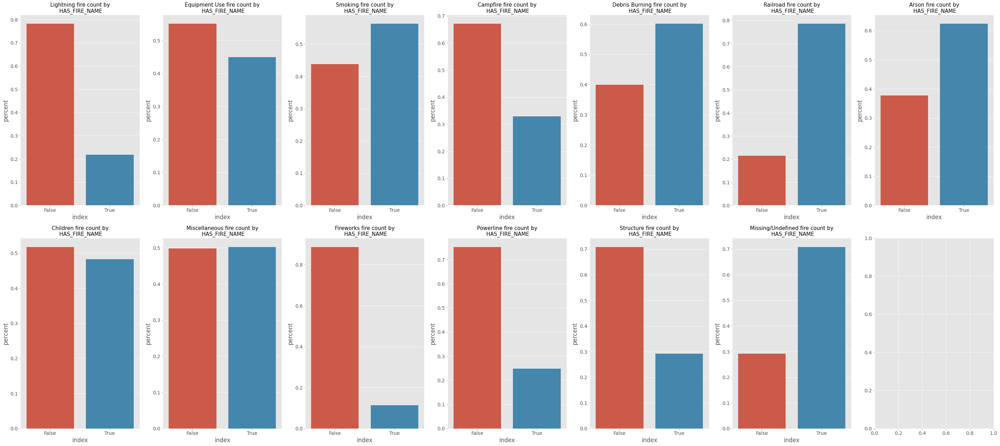

In [54]:
df_train["HAS_FIRE_NAME"] = df_train["FIRE_NAME"].isna()
feature_compare_to_cause(df_train, "HAS_FIRE_NAME", 'STAT_CAUSE_CODE')
df_train = df_train.drop(["HAS_FIRE_NAME"], axis=1)

I think it is worth keeping this feature, it can be leakage but I think it is worth thinking about it, also, it is probably not.

In [55]:
good_has_features.append("FIRE_NAME")

Check ICS_209_INCIDENT_NUMBER and ICS_209_NAME

In [56]:
print(f"Unique values: {df_train['ICS_209_INCIDENT_NUMBER'].unique()}")
print_null_precent(df_train, "ICS_209_INCIDENT_NUMBER")

Unique values: [None 'TX-TXS-066082' 'AK-MID-000399' ... 'FL-FLS-2009-14-0226'
 'FL-FPR-0501' 'ID-PAF-015']
Precent of nulls out of total ICS_209_INCIDENT_NUMBER: 0.9863298439481724


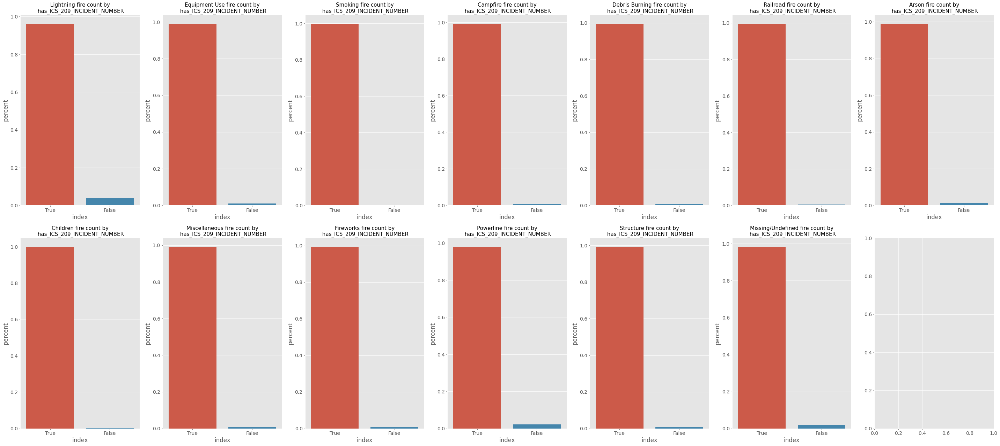

In [57]:
df_train["has_ICS_209_INCIDENT_NUMBER"] = df_train["ICS_209_INCIDENT_NUMBER"].isna()
feature_compare_to_cause(df_train, "has_ICS_209_INCIDENT_NUMBER", 'STAT_CAUSE_CODE')
df_train = df_train.drop(["has_ICS_209_INCIDENT_NUMBER"], axis=1)

We can see that there is no difference between the different responses and whether or not a fire has a feature number, so I choose to remove it.
But first, we will check if its same as ICS_209_NAME




In [58]:
represent_same_values(df_train, 'ICS_209_INCIDENT_NUMBER', 'ICS_209_NAME')

Expected: Bridge, got: Warm Springs for value: ID-CWF-000038


False

It is not exactly the same but let's check if it gets nulls together

In [59]:
are_null_together(df_train, "ICS_209_INCIDENT_NUMBER", "ICS_209_NAME")

True

In [60]:
features_to_delete.append("ICS_209_INCIDENT_NUMBER")
features_to_delete.append("ICS_209_NAME")

Check MTBS_ID

In [61]:
print(f"Check if the feature is a unique identifier: {is_unique_identifier(df_train, 'MTBS_ID')}")

Check if the feature is a unique identifier: False


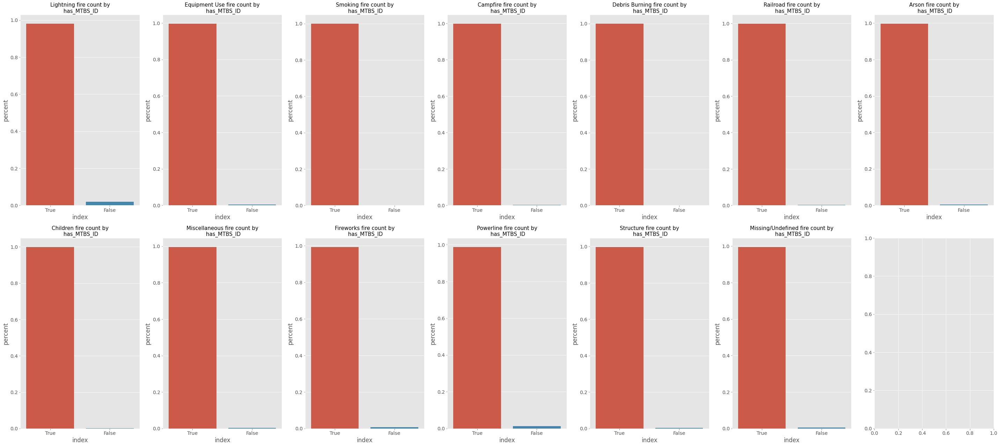

In [62]:
df_train["has_MTBS_ID"] = df_train["MTBS_ID"].isna()
feature_compare_to_cause(df_train, "has_MTBS_ID", 'STAT_CAUSE_CODE')
df_train = df_train.drop(["has_MTBS_ID"], axis=1)

We can see that there is no difference between the different responses and whether or not a fire has a MTBS id, so I choose to remove it.


In [63]:
features_to_delete.append("MTBS_ID")

Check if is the same as MTBS_FIRE_NAME

In [64]:
represent_same_values(df_train, 'MTBS_ID', 'MTBS_FIRE_NAME')

True

In [65]:
features_to_delete.append("MTBS_FIRE_NAME")

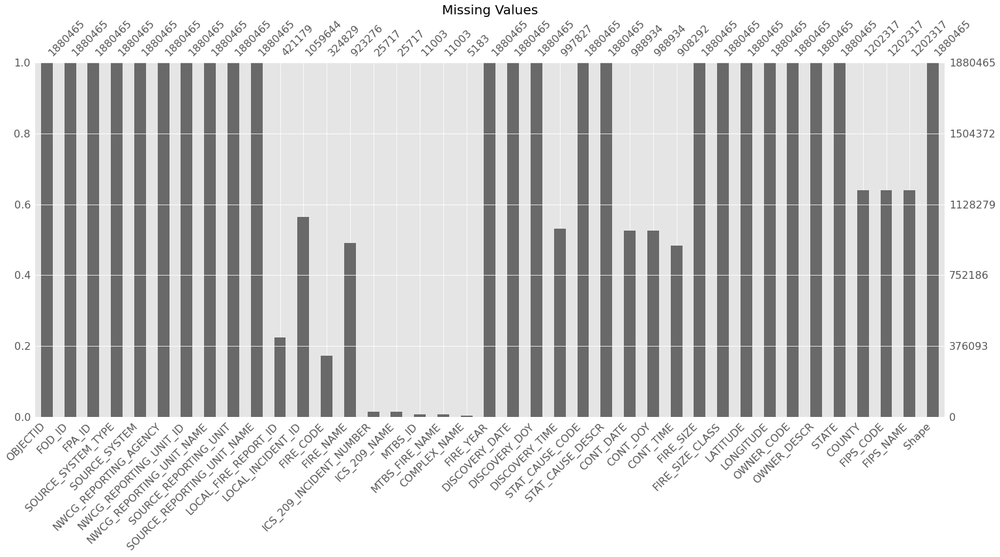

In [66]:
ax = msno.bar(df)
ax.set_title("Missing Values")
plt.show()

In [67]:
df.isna().sum()

OBJECTID                            0
FOD_ID                              0
FPA_ID                              0
SOURCE_SYSTEM_TYPE                  0
SOURCE_SYSTEM                       0
NWCG_REPORTING_AGENCY               0
NWCG_REPORTING_UNIT_ID              0
NWCG_REPORTING_UNIT_NAME            0
SOURCE_REPORTING_UNIT               0
SOURCE_REPORTING_UNIT_NAME          0
LOCAL_FIRE_REPORT_ID          1459286
LOCAL_INCIDENT_ID              820821
FIRE_CODE                     1555636
FIRE_NAME                      957189
ICS_209_INCIDENT_NUMBER       1854748
ICS_209_NAME                  1854748
MTBS_ID                       1869462
MTBS_FIRE_NAME                1869462
COMPLEX_NAME                  1875282
FIRE_YEAR                           0
DISCOVERY_DATE                      0
DISCOVERY_DOY                       0
DISCOVERY_TIME                 882638
STAT_CAUSE_CODE                     0
STAT_CAUSE_DESCR                    0
CONT_DATE                      891531
CONT_DOY    

## Checking and removing leakage columns

In [68]:
print("SOURCE_SYSTEM_TYPE and SOURCE_SYSTEM represent the same value :{}".format(represent_same_values(df_train[df_train.notna()], 'SOURCE_SYSTEM_TYPE', 'SOURCE_SYSTEM')))
print("NWCG_REPORTING_UNIT_ID and NWCG_REPORTING_UNIT_NAME represent the same value :{}".format(represent_same_values(df_train[df_train.notna()], 'NWCG_REPORTING_UNIT_ID', 'NWCG_REPORTING_UNIT_NAME')))
print("SOURCE_REPORTING_UNIT and SOURCE_REPORTING_UNIT_NAME represent the same value :{}".format(represent_same_values(df_train[df_train.notna()], 'SOURCE_REPORTING_UNIT', 'SOURCE_REPORTING_UNIT_NAME')))
print("ICS_209_INCIDENT_NUMBER and ICS_209_NAME represent the same value :{}".format(represent_same_values(df_train[df_train.notna()], 'ICS_209_INCIDENT_NUMBER', 'ICS_209_NAME')))
print("MTBS_ID and MTBS_FIRE_NAME represent the same value :{}".format(represent_same_values(df_train[df_train.notna()], 'MTBS_ID', 'MTBS_FIRE_NAME')))

Expected: ST-CACDF, got: ST-NASF for value: NONFED
SOURCE_SYSTEM_TYPE and SOURCE_SYSTEM represent the same value :False
NWCG_REPORTING_UNIT_ID and NWCG_REPORTING_UNIT_NAME represent the same value :True
Expected: Texas Forest Service - West Zone, got: Texas Forest Service - West Branch for value: TXWZS
SOURCE_REPORTING_UNIT and SOURCE_REPORTING_UNIT_NAME represent the same value :False
Expected: Bridge, got: Warm Springs for value: ID-CWF-000038
ICS_209_INCIDENT_NUMBER and ICS_209_NAME represent the same value :False
MTBS_ID and MTBS_FIRE_NAME represent the same value :True


Therefore we can remove one the columns that are identical like NWCG_REPORTING_UNIT_ID and MTBS_ID

In [69]:
features_to_delete.append('NWCG_REPORTING_UNIT_ID')
features_to_delete.append('MTBS_ID')

features_with_potential_leckage = []

The scale of the y axis is different between each graph.


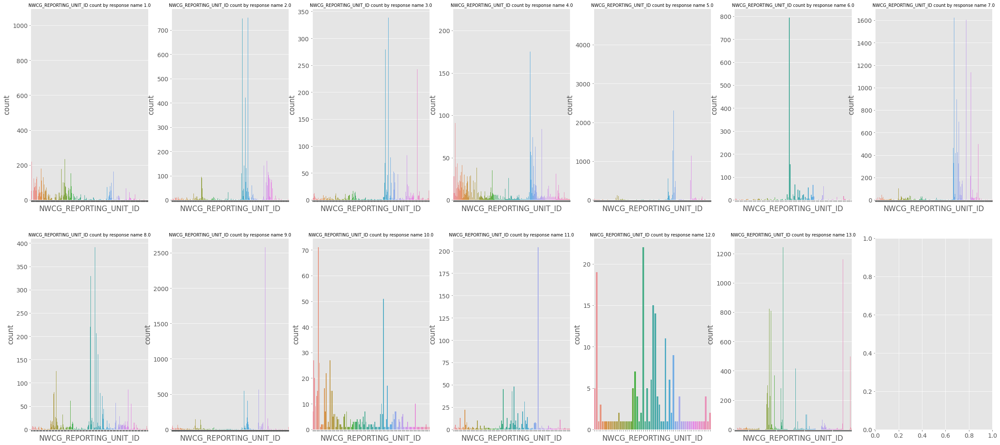

In [70]:
plot_cause_along(sample_df, 'NWCG_REPORTING_UNIT_ID', 'STAT_CAUSE_CODE')

In [71]:
features_with_potential_leckage.append('NWCG_REPORTING_UNIT_ID')

The scale of the y axis is different between each graph.


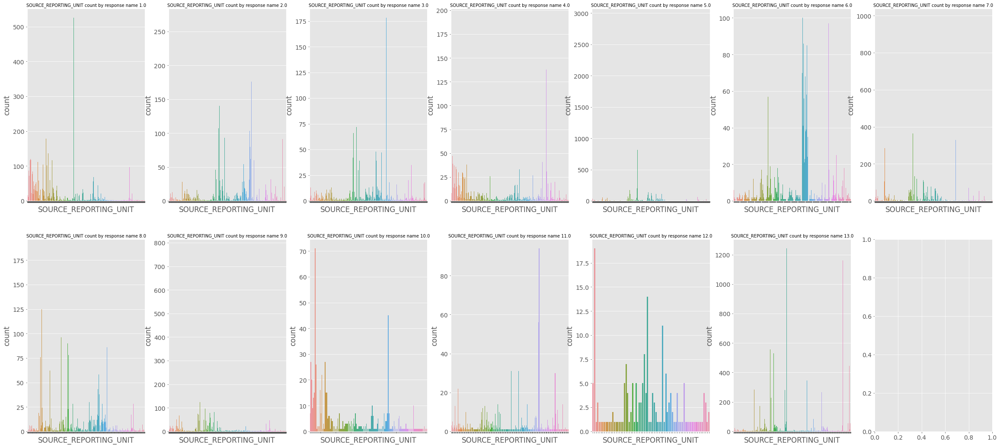

In [72]:
plot_cause_along(sample_df, 'SOURCE_REPORTING_UNIT', 'STAT_CAUSE_CODE')

In [73]:
features_with_potential_leckage.append('SOURCE_REPORTING_UNIT')

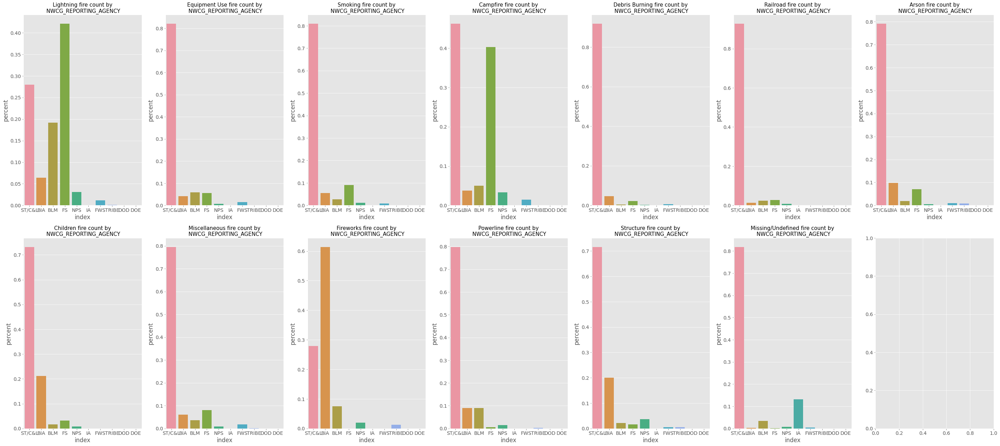

In [74]:
feature_compare_to_cause(sample_df, 'NWCG_REPORTING_AGENCY', 'STAT_CAUSE_CODE')

## Layout of fire locations on a map

In [75]:
import folium

from folium.plugins import HeatMap, MarkerCluster
!pip install geopandas
import geopandas as gpd
import pyproj
import shapely 
from sklearn.cluster import KMeans

     |████████████████████████████████| 1.0 MB 30.0 MB/s 
     |████████████████████████████████| 15.4 MB 143 kB/s 
     |████████████████████████████████| 6.3 MB 51.1 MB/s 


In [76]:
wgs84p=pyproj.Proj("+init=EPSG:4326")
UTM36N=pyproj.Proj("+init=EPSG:32636")

df_geo = gpd.GeoDataFrame(df.sample(30000))
df_geo['geometry'] = df_geo.apply(lambda row: shapely.geometry.point.Point(row['LATITUDE'],row['LONGITUDE']),axis=1)
df_geo.crs ={'init':'epsg:4236','no_defs':True}
df_geo = df_geo.to_crs(epsg='32636')

# df_geo['x'] = df.geometry.x
# df_geo['y'] = df.geometry.y

In [77]:
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'beige', 'darkblue', 'cadetblue', 'lightblue', 'lightgreen', 'gray', 'black']
means = df_geo[['LATITUDE', 'LONGITUDE']].drop_duplicates().mean()
means = [means[0],means[1]]

In [78]:
# ta_coords = [32.109333, 34.855499]
m_1 = folium.Map(location=means,zoom_start=5)
counter = 0
for i, coords in enumerate(list(zip(df_geo['LATITUDE'], df_geo['LONGITUDE']))):
    folium.Circle(coords, radius=50, fill=True, color=colors[df_geo['STAT_CAUSE_CODE'].iloc[i].astype(int)-1]).add_to(m_1)
    # if counter > 50:
    #   break
    # counter += 1

folium.Circle(means, radius=50, fill=True, color="red").add_to(m_1)
m_1

In [79]:
for i, color in enumerate(colors):
  print(color, ":",code_to_cause_dict[i+1])

red : Lightning
blue : Equipment Use
green : Smoking
purple : Campfire
orange : Debris Burning
darkred : Railroad
beige : Arson
darkblue : Children
cadetblue : Miscellaneous
lightblue : Fireworks
lightgreen : Powerline
gray : Structure
black : Missing/Undefined



## Analyzes on features using graphs.

###  Bar plots


[Text(0, 0.5, 'percent')]

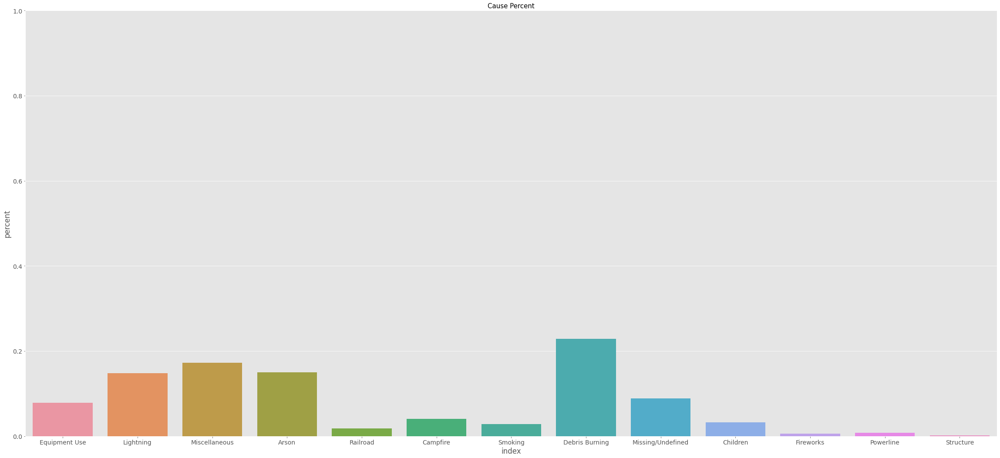

In [80]:
curr = df_train['STAT_CAUSE_DESCR'].value_counts(normalize=True).reset_index()
vals = df_train['STAT_CAUSE_DESCR'].unique()
plot_count = sns.barplot(x='index', y='STAT_CAUSE_DESCR', data=curr, order=vals)
plot_count.set(xticklabels=vals)
plot_count.axes.set_title(f"Cause Percent",fontsize=15)
plot_count.axes.set(ylim=(0, 1))
plot_count.axes.set(ylabel="percent")


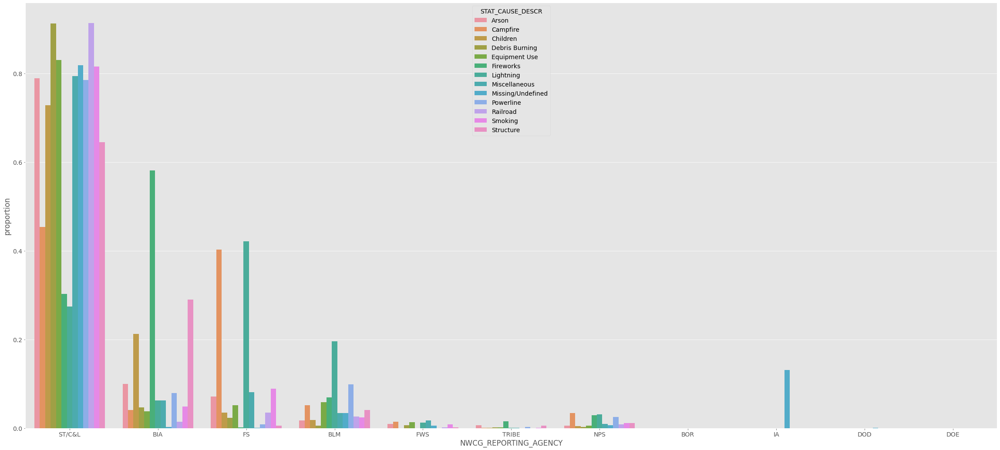

In [81]:
x, y, hue = 'NWCG_REPORTING_AGENCY', "proportion", 'STAT_CAUSE_DESCR'
hue_order = vals

(df_train[x]
 .groupby(df_train[hue])
 .value_counts(normalize=True)
 .rename(y)
 .reset_index()
 .pipe((sns.barplot, "data"), x=x, y=y, hue=hue))

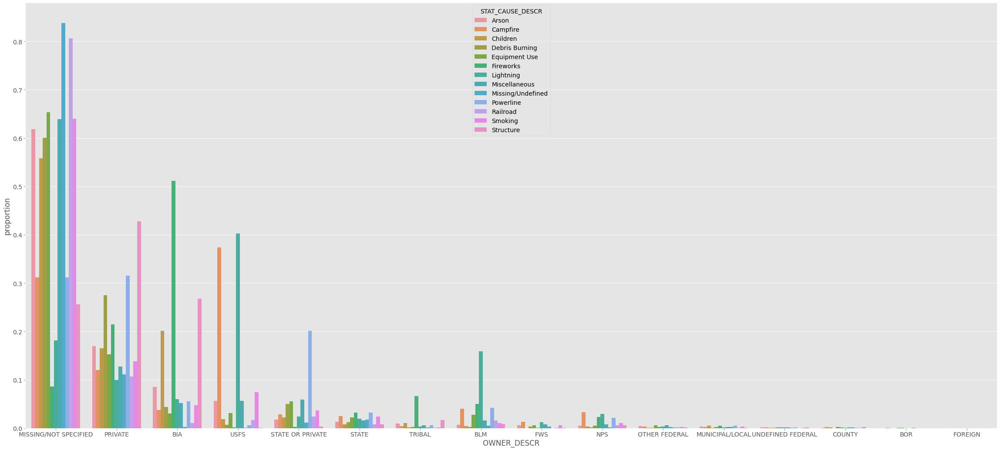

In [82]:
x, y, hue = 'OWNER_DESCR', "proportion", 'STAT_CAUSE_DESCR'
hue_order = vals

(df_train[x]
 .groupby(df_train[hue])
 .value_counts(normalize=True)
 .rename(y)
 .reset_index()
 .pipe((sns.barplot, "data"), x=x, y=y, hue=hue))

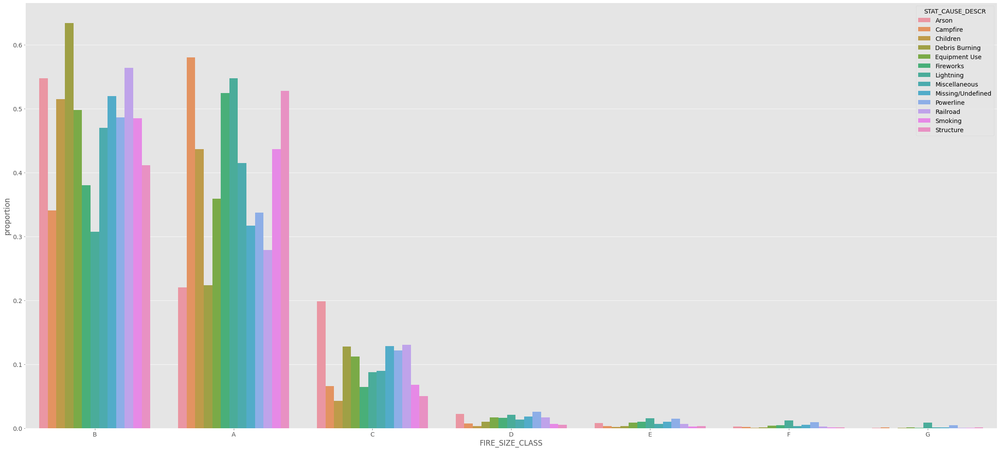

In [83]:
x, y, hue = 'FIRE_SIZE_CLASS', "proportion", 'STAT_CAUSE_DESCR'
hue_order = vals

(df_train[x]
 .groupby(df_train[hue])
 .value_counts(normalize=True)
 .rename(y)
 .reset_index()
 .pipe((sns.barplot, "data"), x=x, y=y, hue=hue))

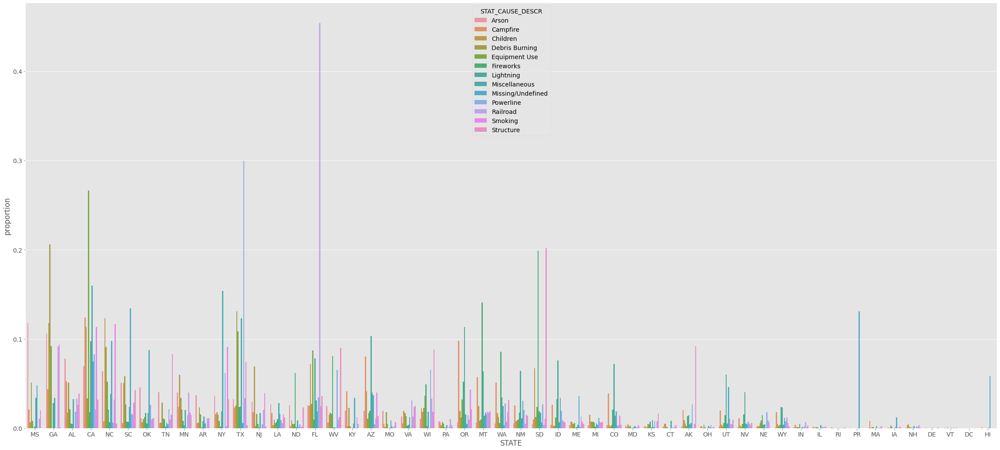

In [84]:
x, y, hue = 'STATE', "proportion", 'STAT_CAUSE_DESCR'
hue_order = vals

(df_train[x]
 .groupby(df_train[hue])
 .value_counts(normalize=True)
 .rename(y)
 .reset_index()
 .pipe((sns.barplot, "data"), x=x, y=y, hue=hue))

In [85]:
unique_cause_values, len_cause_values = df['STAT_CAUSE_DESCR'].unique(), len(df['STAT_CAUSE_DESCR'].unique())
print("The unique values are:{}, total {} values".format(unique_cause_values, len_cause_values))

The unique values are:['Miscellaneous' 'Lightning' 'Debris Burning' 'Campfire' 'Equipment Use'
 'Arson' 'Children' 'Railroad' 'Smoking' 'Powerline' 'Structure'
 'Fireworks' 'Missing/Undefined'], total 13 values


## Correlation heatmap

In [86]:
#Correlation heatmap for all the number values
corr = df.corr()
corr.style.background_gradient(cmap='PuOr_r')

,OBJECTID,FOD_ID,FIRE_YEAR,DISCOVERY_DATE,DISCOVERY_DOY,STAT_CAUSE_CODE,CONT_DATE,CONT_DOY,FIRE_SIZE,LATITUDE,LONGITUDE,OWNER_CODE
OBJECTID,1.000000,0.736625,0.515138,0.512169,-0.075348,0.189755,0.621236,-0.142071,-0.010243,-0.191597,0.213241,0.253951
FOD_ID,0.736625,1.000000,0.683548,0.682485,-0.022077,0.103393,0.749375,-0.058620,0.002855,-0.089132,-0.041952,-0.046291
FIRE_YEAR,0.515138,0.683548,1.000000,0.999316,-0.008885,0.057157,0.999495,-0.005300,0.007048,0.000407,0.015863,-0.025825
DISCOVERY_DATE,0.512169,0.682485,0.999316,1.000000,0.028105,0.052594,0.999983,0.025711,0.007260,0.005821,0.006870,-0.030869
DISCOVERY_DOY,-0.075348,-0.022077,-0.008885,0.028105,1.000000,-0.122816,0.020174,0.994455,0.005810,0.146405,-0.243033,-0.136616
STAT_CAUSE_CODE,0.189755,0.103393,0.057157,0.052594,-0.122816,1.000000,0.014417,-0.182347,-0.021364,-0.155831,0.182501,0.295973
CONT_DATE,0.621236,0.749375,0.999495,0.999983,0.020174,0.014417,1.000000,0.026053,0.007157,0.053056,0.064048,0.083508
CONT_DOY,-0.142071,-0.058620,-0.005300,0.025711,0.994455,-0.182347,0.026053,1.000000,0.023466,0.165286,-0.279124,-0.159852
FIRE_SIZE,-0.010243,0.002855,0.007048,0.007260,0.005810,-0.021364,0.007157,0.023466,1.000000,0.038860,-0.039731,-0.029635
LATITUDE,-0.191597,-0.089132,0.000407,0.005821,0.146405,-0.155831,0.053056,0.165286,0.038860,1.000000,-0.354727,-0.304302


## Histogram 

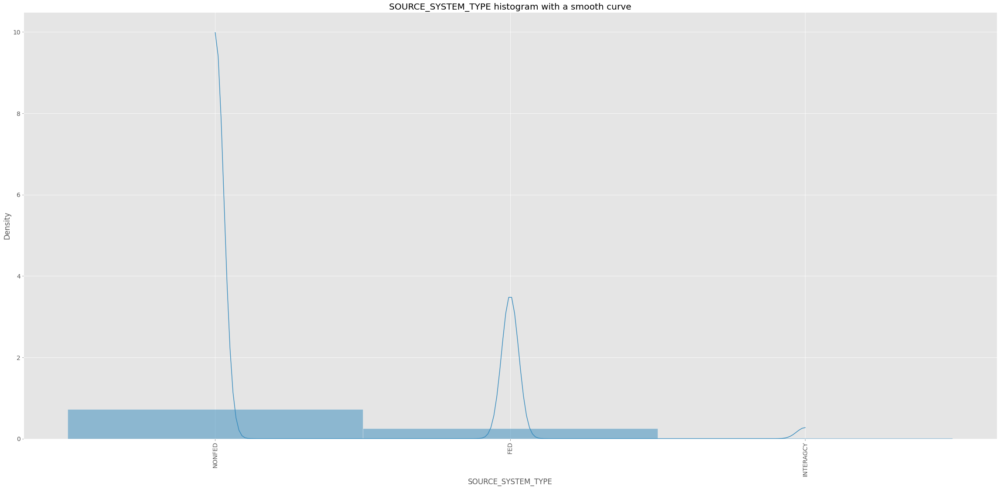

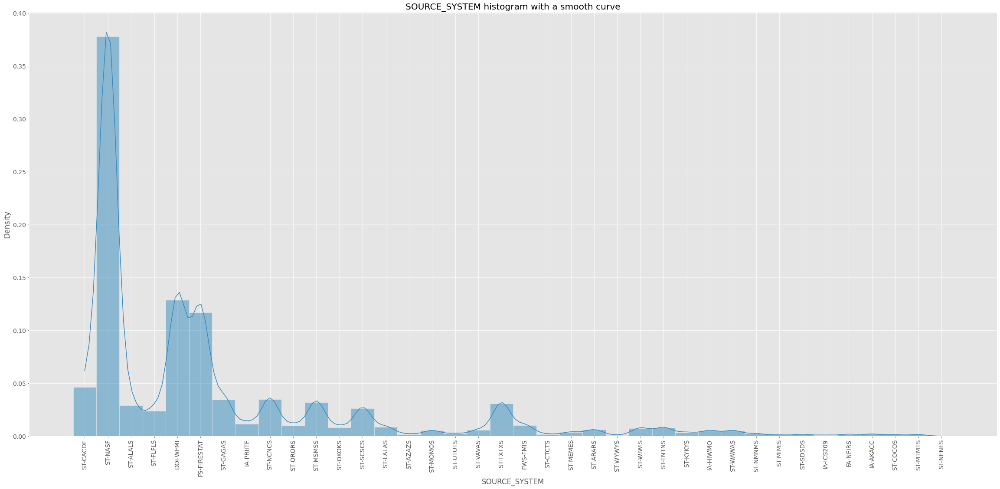

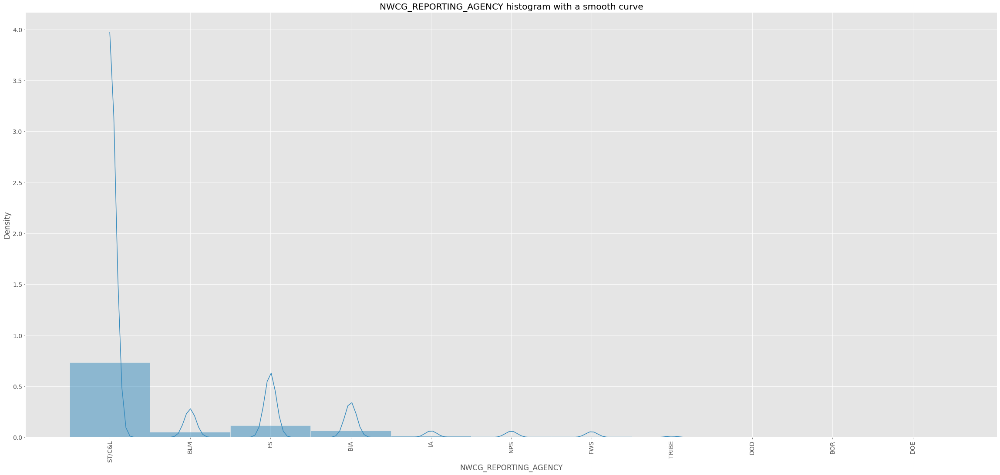

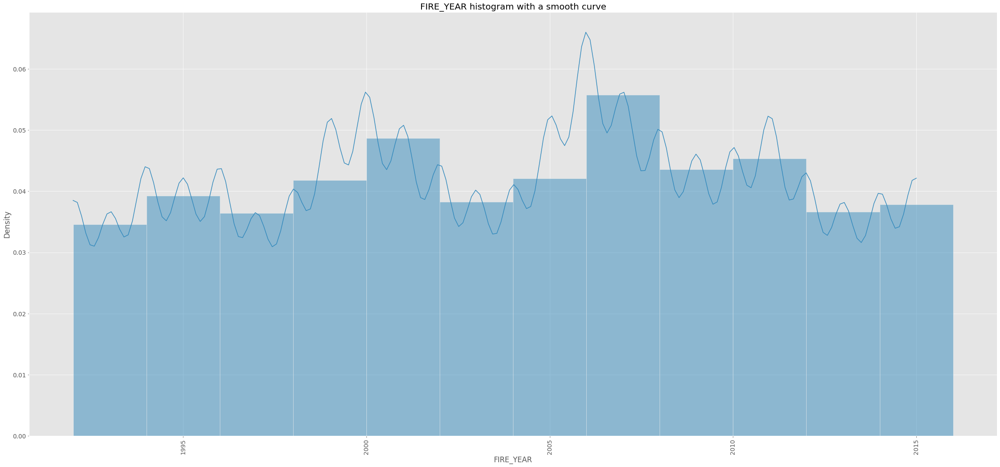

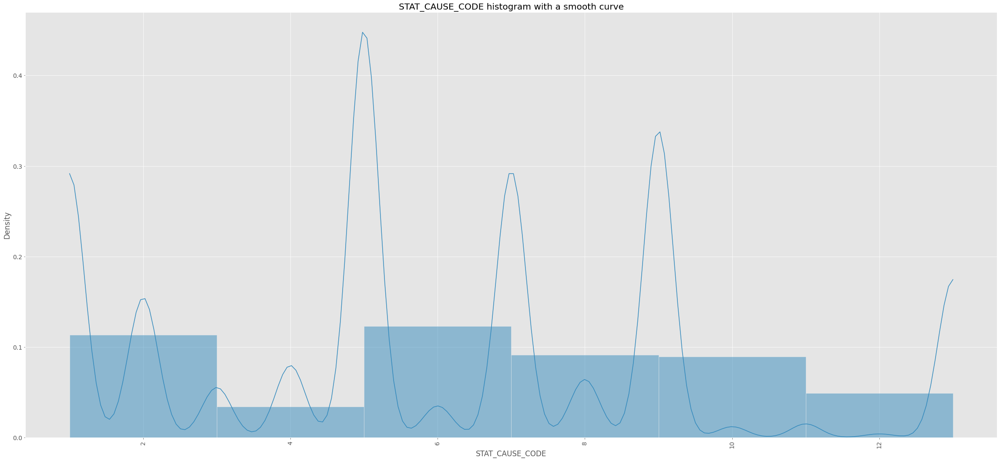

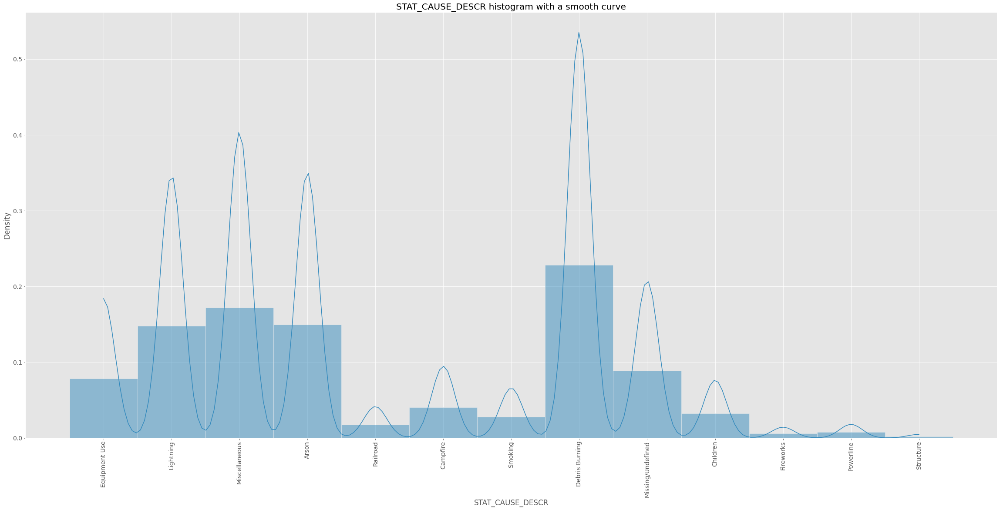

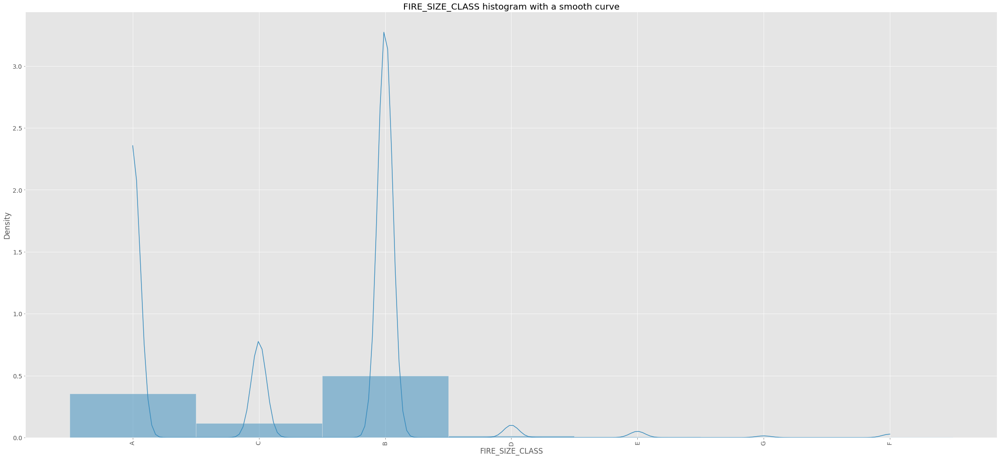

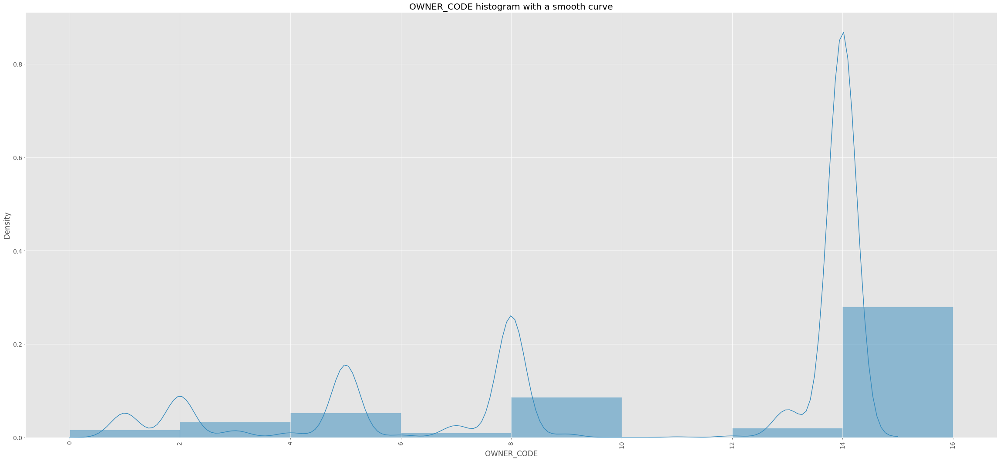

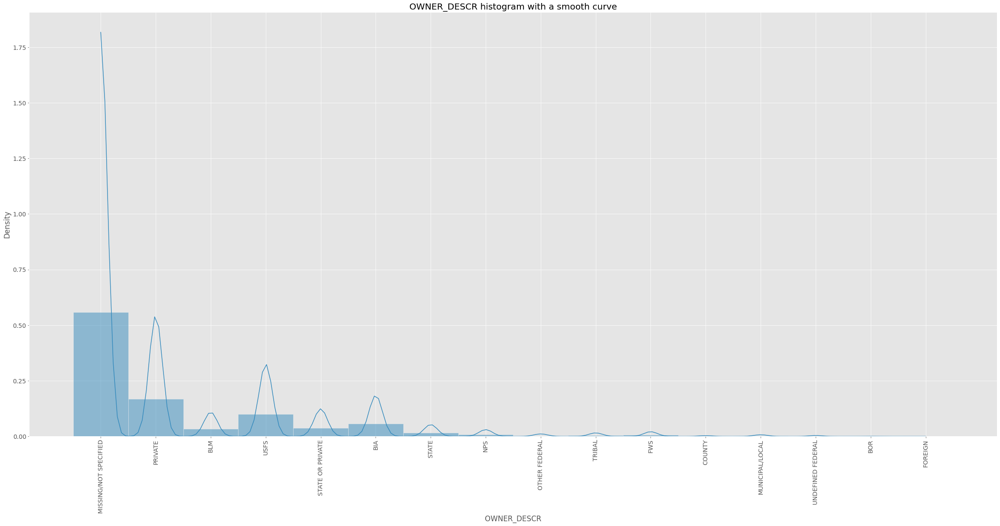

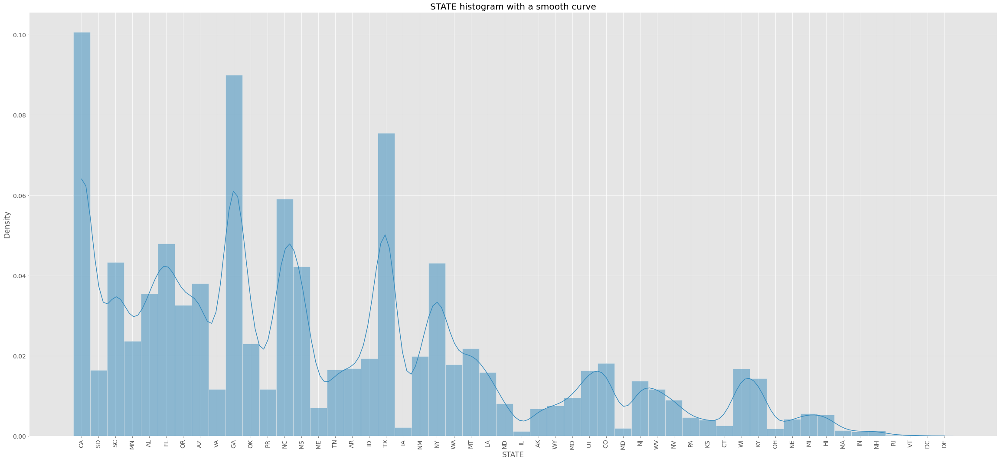

In [87]:
for column in df_train.columns[3:]:
    if len(df[column].unique()) > 100:
      continue
    sns.histplot(data=df_train,x=column, binwidth=2, kde=True, stat='density').set_title("{} histogram with a smooth curve".format(column))
    plt.xticks(rotation=90)
    plt.show()

## convert to date_time

In [88]:
df_train = adding_dates_data(df_train, features_to_delete)

## Plot alog time

In [89]:
grouped_seasons = df_train.groupby(by=['DISCOVERY_WOY', 'FIRE_YEAR', 'STAT_CAUSE_DESCR']).size().sort_index().reset_index().rename({0:"Count"}, axis=1)
grouped_seasons['Date'] = grouped_seasons['FIRE_YEAR'].astype(str) + "/" + grouped_seasons['DISCOVERY_WOY'].astype(str)

In [90]:
grouped_seasons.head()

,DISCOVERY_WOY,FIRE_YEAR,STAT_CAUSE_DESCR,Count,Date
0,1,1992,Arson,70,1992/1
1,1,1992,Campfire,1,1992/1
2,1,1992,Children,11,1992/1
3,1,1992,Debris Burning,36,1992/1
4,1,1992,Equipment Use,27,1992/1


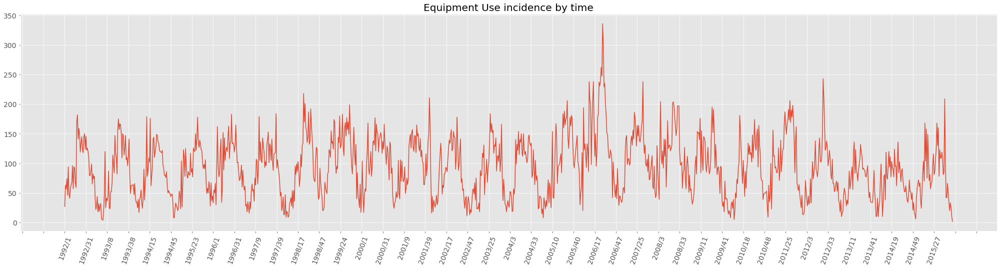

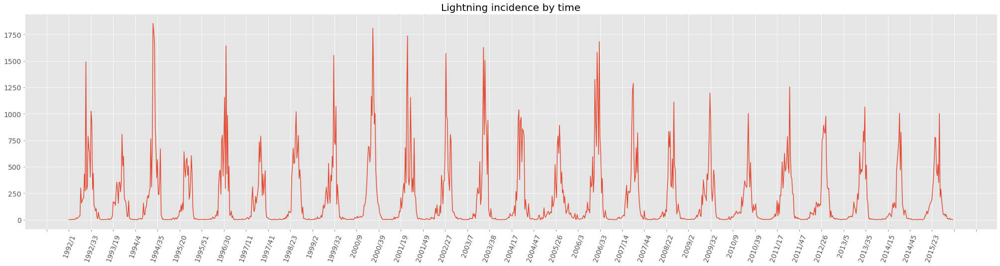

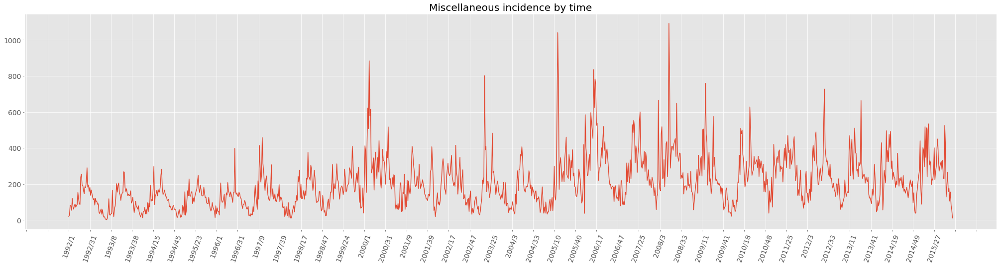

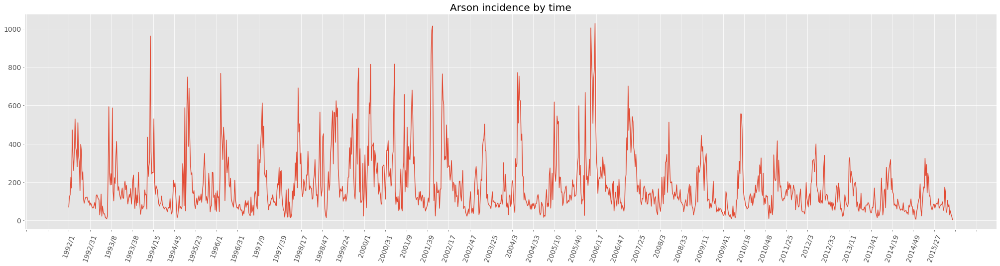

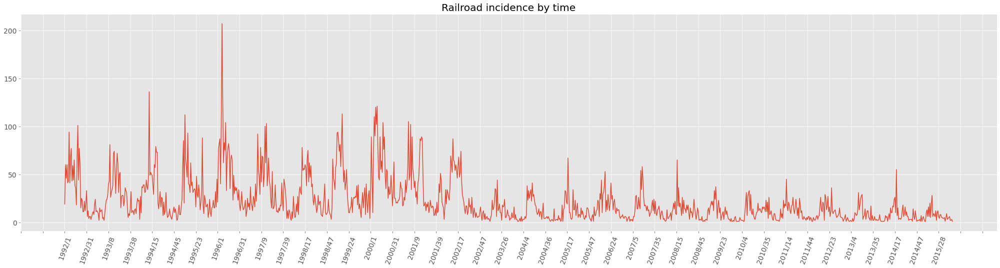

...

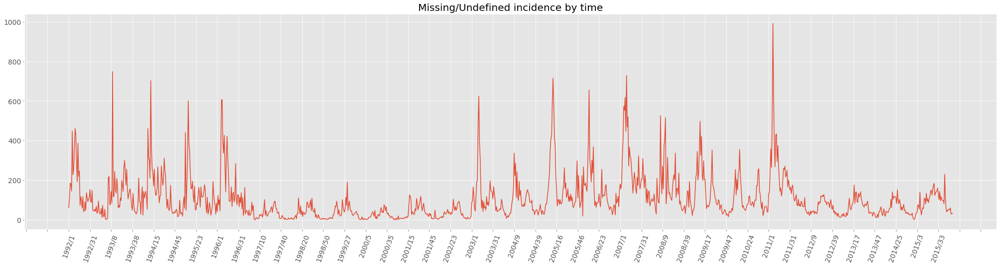

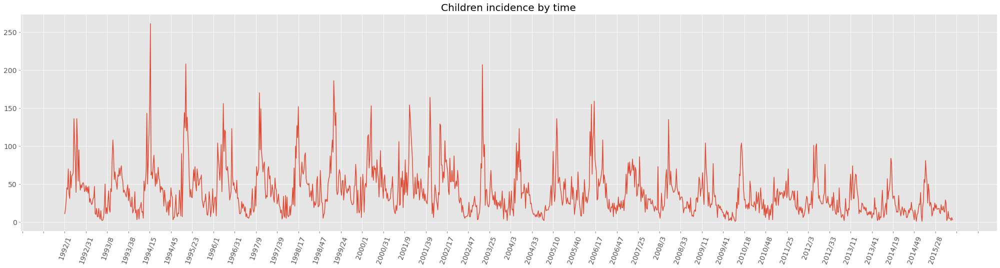

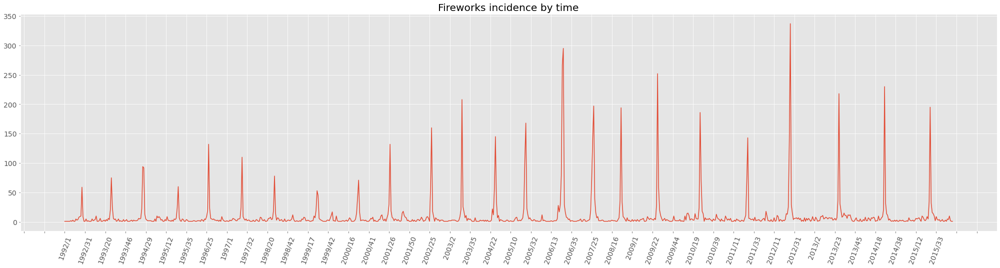

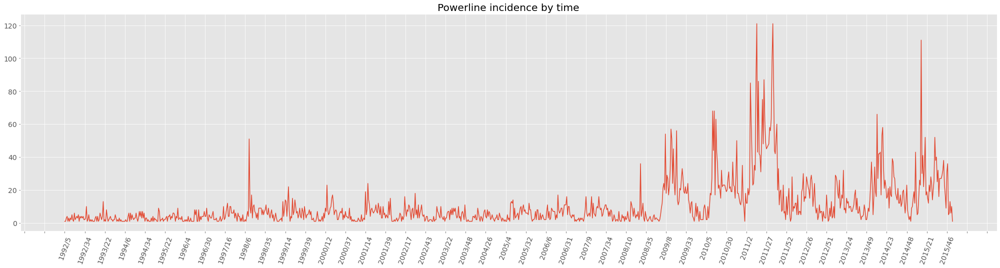

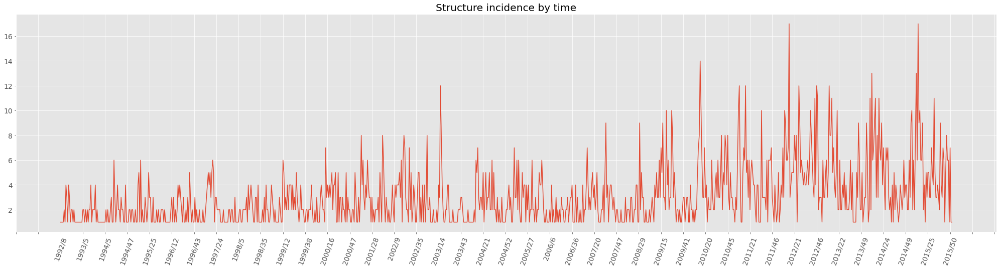

In [91]:
cause_values = df_train['STAT_CAUSE_DESCR'].unique()

for cause in cause_values:
  relevant_values = grouped_seasons.iloc[np.where(grouped_seasons['STAT_CAUSE_DESCR'] == cause)].sort_values(by=['FIRE_YEAR','DISCOVERY_WOY']).reset_index()
  
  fig,ax = plt.subplots(figsize=(35,8))
  ax.set_title(f'{cause} incidence by time')
  plt.plot('Date', 'Count', data=relevant_values)
  ax.xaxis.set_major_locator(plt.MaxNLocator(52))
  plt.xticks(rotation=70)

  
  plt.show()

## Observing spatial data.

In [92]:
lod_sample_df = sample_df[['FIRE_SIZE','FIRE_SIZE_CLASS','LATITUDE','LONGITUDE','OWNER_CODE','OWNER_DESCR','STATE','COUNTY','FIPS_CODE','FIPS_NAME']]
lat_lon = lod_sample_df[['FIRE_SIZE']]
check_test = lod_sample_df['FIRE_SIZE_CLASS']
#lat_lon = pd.get_dummies(lat_lon,columns=['OWNER_DESCR'])
X_train, X_test, y_train, y_test = train_test_split(lat_lon, check_test)

In [93]:
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier().fit(X_train, y_train)
model.score(X_test,y_test)
features_to_delete.append('FIRE_SIZE_CLASS')

By examining which columns can be 100% accurately predicted using other columns we have come to the conclusion which columns are unnecessary.

Reduce cardinality example

# Feature Engineering - Functions

## Categorial features

In [94]:
features_to_delete.append("OWNER_CODE")
features_to_delete.append('FIRE_CODE')  # replace by HAS_FIRE_CODE
features_to_delete.append('COMPLEX_NAME')
features_to_delete.append('FIPS_CODE')
features_to_delete.append('COUNTY')
features_to_delete.append('Shape')

Looking at all the columns after cleaning the data

SOURCE_SYSTEM_TYPE - decide to represent using one-hot since there are 3 categories

In [95]:
print_categorial_info(df_train, 'SOURCE_SYSTEM_TYPE')

name:SOURCE_SYSTEM_TYPE, cardinality:3, precent of null values:0.0


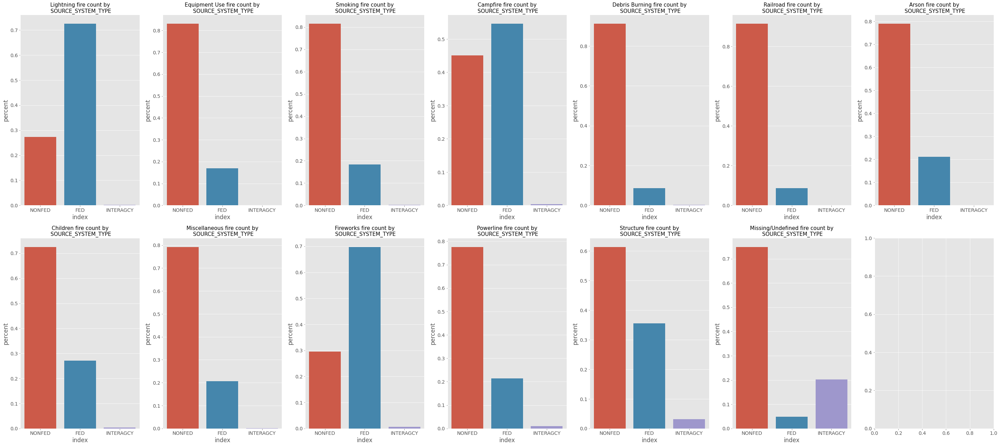

In [96]:
feature_compare_to_cause(df_train, 'SOURCE_SYSTEM_TYPE', 'STAT_CAUSE_CODE')

In [97]:
features_to_delete.append('SOURCE_SYSTEM_TYPE')

SOURCE_SYSTEM




In [98]:
print_categorial_info(df_train, 'SOURCE_SYSTEM')

name:SOURCE_SYSTEM, cardinality:38, precent of null values:0.0


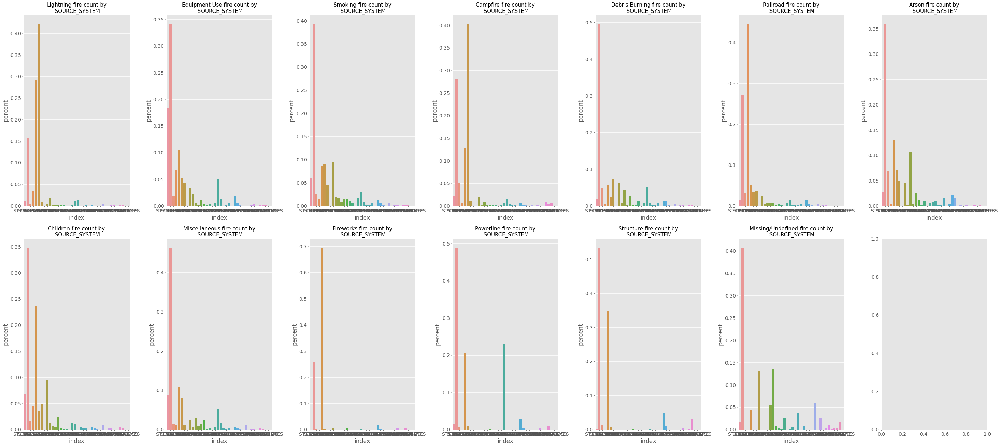

In [99]:
feature_compare_to_cause(df_train, 'SOURCE_SYSTEM', 'STAT_CAUSE_CODE')

In [100]:
categorial_features.append('SOURCE_SYSTEM')

NWCG_REPORTING_AGENCY

In [101]:
print_categorial_info(df_train, 'NWCG_REPORTING_AGENCY')

name:NWCG_REPORTING_AGENCY, cardinality:11, precent of null values:0.0


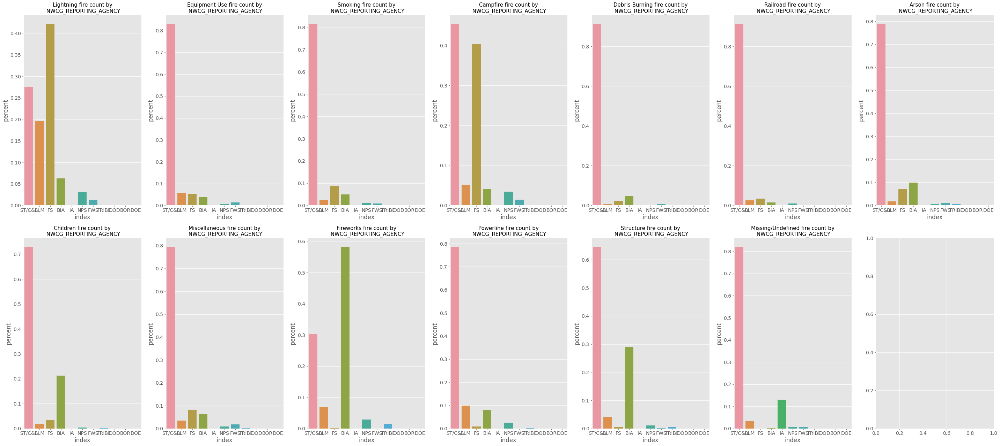

In [102]:
feature_compare_to_cause(df_train, 'NWCG_REPORTING_AGENCY', 'STAT_CAUSE_CODE')

In [103]:
one_hot_features.append('NWCG_REPORTING_AGENCY')

NWCG_REPORTING_UNIT_NAME

In [104]:
cause_one_hot = pd.get_dummies(df_train['STAT_CAUSE_DESCR'])

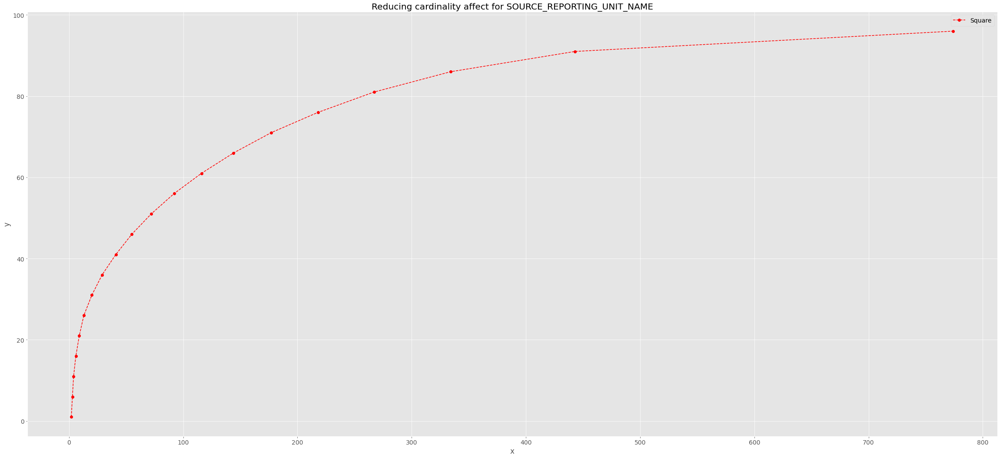

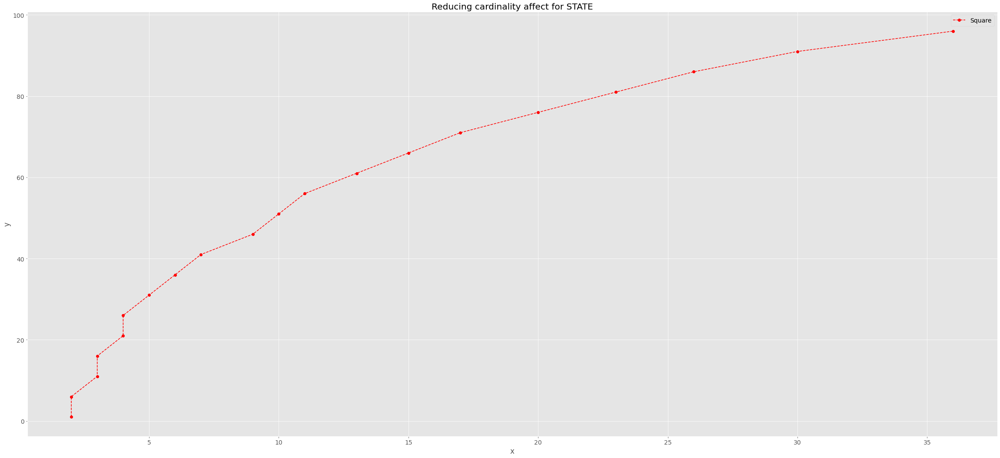

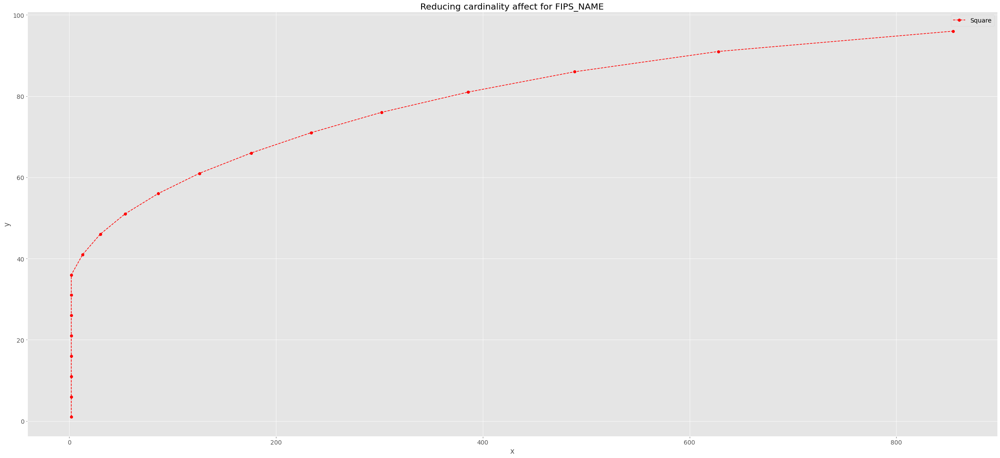

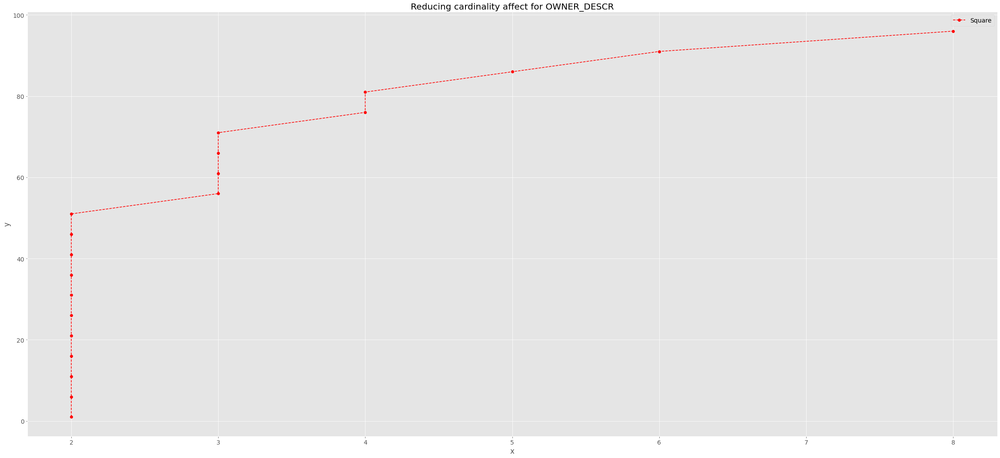

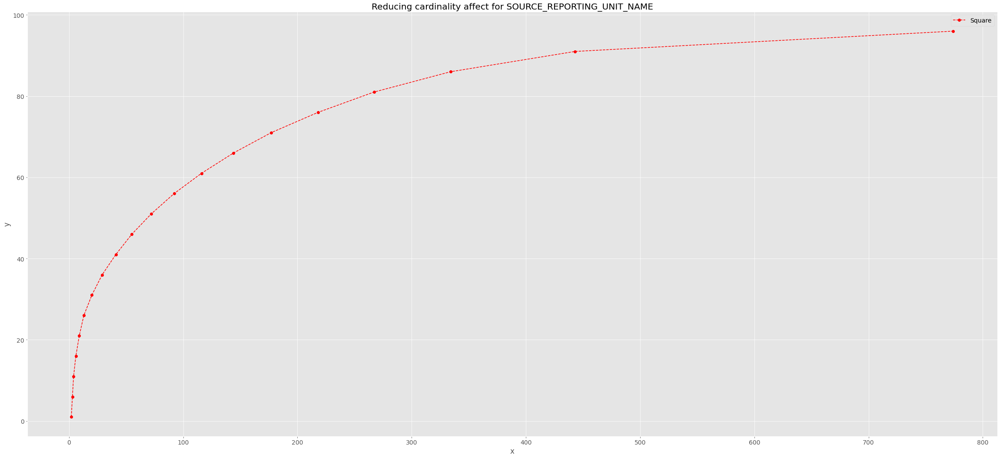

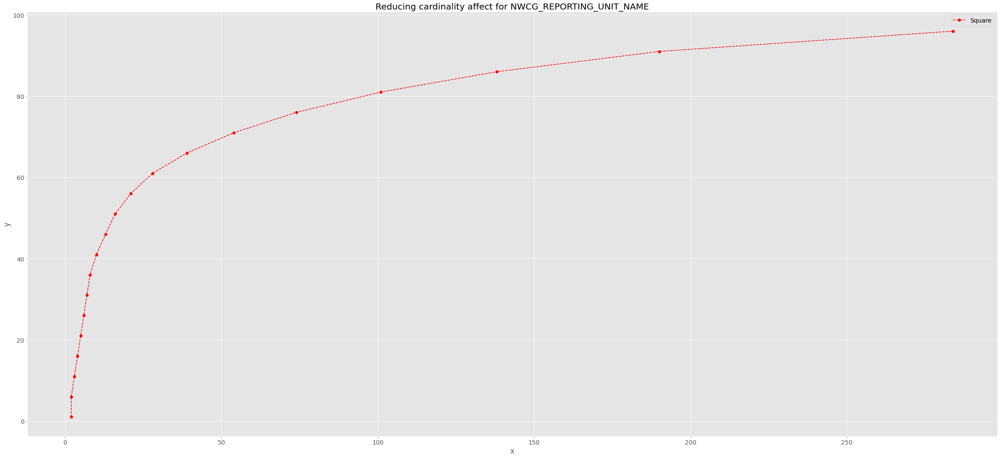

In [105]:
categorial_features_card = ['SOURCE_REPORTING_UNIT_NAME', 'STATE', 'FIPS_NAME', 'OWNER_DESCR', 'SOURCE_REPORTING_UNIT_NAME', 'NWCG_REPORTING_UNIT_NAME']

for category_name in categorial_features_card:
  plot_cardinality_over_size(df_train[category_name], category_name)


In [106]:
one_hot_features.extend([
  'STATE', 'OWNER_DESCR'
])

## Engineering Functions

In [128]:
def features_to_one_hot(df, one_hot_features, ohe, is_test):
  """
  Switches the feature representation to one hot and deletes the original
  """
  if not is_test:
    feature_arr = ohe.fit_transform(df[one_hot_features])
  else:
    feature_arr = ohe.transform(df[one_hot_features])
  feature_labels = ohe.categories_
  labels = []
  for i, category in enumerate(feature_labels):
    labels.extend(one_hot_features[i] + "_" + category.ravel())
  features = pd.DataFrame(feature_arr,columns= labels,index=df.index)
  return pd.concat([df.drop(one_hot_features, axis=1), features], axis=1)
  


In [129]:
def partial_one_hot(df, column_name, encode_values, drop=False):
  column_names = []
  
  for value in encode_values:
    column_names.append(f"{column_name}_{value}")
    df[column_names[-1]] = np.where(df[column_name]==value,1,0)
  
  if drop:
    df.drop(columns={column_name}, inplace=True)
  
  return column_names

### Adding features
feature engeneering - add features to the data frame

In [130]:
def calc_duration(row):
  for value in ['CONT_DATE', 'CONT_TIME', 'DISCOVERY_TIME', 'DISCOVERY_DATE']:
    if row[value] is None:
      return

  return datetime.combine(row['CONT_DATE'], row['CONT_TIME']) - datetime.combine(row['DISCOVERY_DATE'], row['DISCOVERY_TIME'])


def give_value_by_group(cur_value, values, grouped_mean_df, second_group_mean): 
  if cur_value == cur_value:
    return cur_value

  for value in values:
    if value is None:
      return
   
  return grouped_mean_df.loc[values] if values in grouped_mean_df.index else second_group_mean.loc[values[0]]

In [131]:
def is_holiday(df, date_column):
  cal = calendar()
  holidays = cal.holidays(start=df[date_column].min(), end=df[date_column].max())
  df[f'isHoliday_{date_column}'] = df[date_column].isin(holidays)

In [132]:
def increased_poweline(row):
  if row['FIRE_YEAR'] > 2009 or (row['FIRE_YEAR'] == 2009 and row['DISCOVERY_WOY'] >=4):
    return 1  
  return 0

def missing_values_decrease(row):
  if row['FIRE_YEAR'] > 1996 and row['FIRE_YEAR'] < 2003 or (row['FIRE_YEAR'] == 1996 and row['DISCOVERY_WOY'] >= 41):
    return 1

  if row['FIRE_YEAR'] > 2012 and row['FIRE_YEAR'] < 2015:
    return 1
  
  if (row['FIRE_YEAR'] == 2012 and row['DISCOVERY_WOY'] <= 9) and (row['FIRE_YEAR'] == 2015 and row['DISCOVERY_WOY'] <= 33):
    return 1

  return 0

def decrease_rail(row):
  if row['FIRE_YEAR'] >= 1992 and row['FIRE_YEAR'] < 2002:
    return 1
  if row['FIRE_YEAR'] == 2002 and row['DISCOVERY_WOY'] < 41:
    return 1
  return 0

In [133]:
def cyclical_transform_datetime_feature(df, datetime_feature):
    seconds_in_day = 24*60*60
    seconds_in_week = 7 * seconds_in_day

    df[datetime_feature + '_time_in_seconds'] = pd.to_datetime(df[datetime_feature]).values.astype(np.int64) // 10**6

    df[datetime_feature + '_day_sin_time'] = np.sin(2*np.pi*df[datetime_feature + '_time_in_seconds']/seconds_in_day)
    df[datetime_feature + '_day_cos_time'] = np.cos(2*np.pi*df[datetime_feature + '_time_in_seconds']/seconds_in_day)
    df[datetime_feature + '_sin_time_week'] = np.sin(2*np.pi*df[datetime_feature + '_time_in_seconds']/seconds_in_week)
    df[datetime_feature + '_cos_time_week'] = np.cos(2*np.pi*df[datetime_feature + '_time_in_seconds']/seconds_in_week)

In [134]:
def cyclical_transform_time_feature(df, hour_feature_name, features_to_delete):
  df.hour_feature_name = df_train[hour_feature_name].apply(lambda x: x.hour + x.minute/60 if not x is None else None)

  df[f'{hour_feature_name}_hr_sin'] = np.sin(df.hour_feature_name*(2.*np.pi/24))
  df[f'{hour_feature_name}_hr_cos'] = np.cos(df.hour_feature_name*(2.*np.pi/24))

  features_to_delete.append(hour_feature_name)

In [135]:
def add_features(df, good_has_features):
  """
  Adds features to the dataframe
  """
  # Time
  df['WEEKDAY'] =  df['DISCOVERY_DATE'].dt.weekday  # add day of week column

  cyclical_transform_datetime_feature(df, 'DISCOVERY_DATE')
  cyclical_transform_datetime_feature(df, 'CONT_DATE')

  ## adding features to the data sets
  cyclical_transform_time_feature(df_train, 'CONT_TIME', features_to_delete)
  cyclical_transform_time_feature(df_train, 'DISCOVERY_TIME', features_to_delete)
  
  df['Area_of_independent'] = ((df['DISCOVERY_WOY'] > 23) & (df['DISCOVERY_WOY'] < 27)).astype(int)

  df['increased_poweline_cases'] = df.apply(increased_poweline, axis=1)
  df['decreased_missing_values'] = df.apply(missing_values_decrease, axis=1)
  df['decreased_railroad'] = df.apply(decrease_rail, axis=1)
  df['increased_lighting_cases'] = df['DISCOVERY_WOY'].apply(lambda x:1 if x >= 19 and x<= 41 else 0)


  df['DURATION'] = df.apply(calc_duration,axis=1).astype('timedelta64[s]')



  # scale the DURATION
  df['DURATION'] = (df['DURATION']-df['DURATION'].min())/(df['DURATION'].max()-df['DURATION'].min())

  # Adding holidays
  is_holiday(df, "DISCOVERY_DATE")
  is_holiday(df, "CONT_DATE")

  # "has" features
  for feature in good_has_features:
    df = add_has_feature(df, feature)
  # # remove original features
  df = df.drop(good_has_features, axis=1, errors='ignore')


  return df

A function to add has_feature feature

In [136]:
def add_has_feature(df, feature):
  """
  Adds has_feature to the df while removing the feature itself
  """
  df[f"HAS_{feature}"] = df[feature].isna()
  return df

After looking on the graphs that show the cases of each cause during the weeks of the year, we noticed that in some weeks in the year there are times with increase cases of some cause.
Therefore we decided to add some boolean values to help the model to learn faster.

We thought that the duration of the fire can be relevant to the cause of the fire. After calculating for each incidence we saw that about 50% of the values of the duration are missing, we sum from the mean of the year and the state to guess the real value of the duration of the missing values.

# (not well) Experiments

##Clustring by geographic data

In [107]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

sample_small = df_train.sample(20000)[['LATITUDE', 'LONGITUDE', 'STAT_CAUSE_CODE']]
sample_small_train, sample_small_test = train_test_split(sample_small, test_size=0.2, random_state=2)

# checking if has potential to clustring by area

In [108]:
clustering = AgglomerativeClustering(n_clusters=50).fit(sample_small_train[['LATITUDE', 'LONGITUDE']])

In [109]:
sample_small_train['cluster_space'] = clustering.labels_
sample_small_test['cluster_space'] = clustering.fit_predict(sample_small_test[['LATITUDE', 'LONGITUDE']])

In [110]:
sample_small_test['cluster_space']

450697      1
1133588    39
394346     21
821783      8
1350729    18
           ..
680998      6
911451     13
983089     21
1449402    15
1156201    27
Name: cluster_space, Length: 4000, dtype: int64

In [111]:
sample_small.columns

Index(['LATITUDE', 'LONGITUDE', 'STAT_CAUSE_CODE'], dtype='object')

In [112]:
cluster_dict = dict()

for i in range(50):
  cur_df = sample_small_train[sample_small_train['cluster_space'] == i]
  cluster_dict[i] = cur_df.STAT_CAUSE_CODE.mode()

In [113]:
sample_small_test['cluster_space_pred'] = 1
sample_small_train['cluster_space_pred'] = 1

In [114]:
sample_small_test['cluster_space_pred'] = sample_small_test['cluster_space'].apply(lambda x: cluster_dict[x])
sample_small_train['cluster_space_pred'] = sample_small_train['cluster_space'].apply(lambda x: cluster_dict[x])

In [115]:
len(sample_small_test[sample_small_test['cluster_space_pred'] == sample_small_test['STAT_CAUSE_CODE']]) / len(sample_small_test)

0.221

In [116]:
sample_small_train.columns

Index(['LATITUDE', 'LONGITUDE', 'STAT_CAUSE_CODE', 'cluster_space',
       'cluster_space_pred'],
      dtype='object')

In [117]:
from sklearn.ensemble import RandomForestClassifier

clf_w = RandomForestClassifier(random_state=0)
clf_w.fit(sample_small_train[['LATITUDE', 'LONGITUDE','cluster_space_pred']], sample_small_train[['STAT_CAUSE_CODE']])

clf_o = RandomForestClassifier(random_state=0)
clf_o.fit(sample_small_train[['LATITUDE', 'LONGITUDE']], sample_small_train[['STAT_CAUSE_CODE']])



RandomForestClassifier(random_state=0)

In [118]:
accuracy_score(sample_small_test[['STAT_CAUSE_CODE']], clf_w.predict(sample_small_test[['LATITUDE', 'LONGITUDE','cluster_space_pred']]))

0.3335

In [119]:
accuracy_score(sample_small_test[['STAT_CAUSE_CODE']], clf_o.predict(sample_small_test[['LATITUDE', 'LONGITUDE']]))

0.40275

We can see that the accuracy is getting low when using the cluster feature. Therefore we decided to remove it

## Add weather data

load weather events dataset

In [137]:
weather_events_path = '/content/drive/MyDrive/APLDS/weather_events_processed.csv'
weather_events_df = pd.read_csv(weather_events_path, parse_dates=['END_DATE', 'DISCOVERY_DATE']).drop(columns=['Unnamed: 0'])

Merge on date of fire and date of weather event

In [138]:
df_train_weather_merged_on_date = df_train.merge(weather_events_df, on='DISCOVERY_DATE')
df_train_weather_merged_on_date.shape

(2778418, 52)

filter out only events (fire + weather) that were close to each other

In [139]:
df_train_weather_merged_on_date_and_location = df_train_weather_merged_on_date.query('abs(LATITUDE_x-LATITUDE_y)<=1 and abs(LONGITUDE_x-LONGITUDE_y)<=1')
df_train_weather_merged_on_date_and_location.shape

(3692, 52)

As we can see, there is only a small itersection between our fire data and weather data, with these few examples it will not be befifitial to our model to add these features

In [140]:
def reducing_cardinality(df,feature_to_reduce_cardinality,thershold):
  for feature in feature_to_reduce_cardinality:
    new_col, categories_list = cumulatively_categorise(df[feature], thershold, other_name=f'Other_{feature}')
    df[feature] = new_col

Preprocess

In [141]:
feature_to_reduce_cardinality = ['NWCG_REPORTING_UNIT_NAME','SOURCE_REPORTING_UNIT_NAME','FIPS_NAME','SOURCE_REPORTING_UNIT_NAME']

In [142]:
def preprocess(df, features_to_delete, good_has_features, one_hot_features,feature_to_reduce_cardinality,ohe,is_test):
  """
  Returns the df after preprocessing.
  """
  print("Starting date processing")

  df = adding_dates_data(df, features_to_delete)

  print("Finished date processing")


  print("Starting adding features")
  df = add_features(df, good_has_features)
  print("Finished adding feature")

  print("Starting cleaning data")
  df = clean_data(df, features_to_delete)
  print("Finished cleaning data")

  # cardinality removal
  # to match all uses of preprocess function - load pickled file 
  # with open(drive_project_dir + cause_one_hot_pickle_fn, 'rb') as f:
  #   cause_one_hot = pickle.load(f)
  
  #Adding one hot representation for not all values
  reducing_cardinality(df,feature_to_reduce_cardinality,thershold=0.8)
  # reducing_cardinality_correlation(df, 'NWCG_REPORTING_UNIT_NAME', cause_one_hot ,0.8, True, one_hot_features)
  # reducing_cardinality_correlation(df, 'SOURCE_REPORTING_UNIT_NAME', cause_one_hot ,0.8, True, one_hot_features)
  # reducing_cardinality_correlation(df, 'FIPS_NAME', cause_one_hot ,0.8, True, one_hot_features)
  # reducing_cardinality_correlation(df, 'SOURCE_REPORTING_UNIT_NAME', cause_one_hot ,0.8, True, one_hot_features)

  # Adding one hot
  print("Starting adding one hot")
  df = features_to_one_hot(df, one_hot_features,ohe,is_test)  # todo: currently causing troubles
  print("Finished adding one hot")

  return df

In [143]:
df_train.head()

,OBJECTID,FOD_ID,FPA_ID,SOURCE_SYSTEM_TYPE,SOURCE_SYSTEM,NWCG_REPORTING_AGENCY,NWCG_REPORTING_UNIT_ID,NWCG_REPORTING_UNIT_NAME,SOURCE_REPORTING_UNIT,SOURCE_REPORTING_UNIT_NAME,LOCAL_FIRE_REPORT_ID,LOCAL_INCIDENT_ID,FIRE_CODE,FIRE_NAME,ICS_209_INCIDENT_NUMBER,ICS_209_NAME,MTBS_ID,MTBS_FIRE_NAME,COMPLEX_NAME,FIRE_YEAR,DISCOVERY_DATE,DISCOVERY_DOY,DISCOVERY_TIME,STAT_CAUSE_CODE,STAT_CAUSE_DESCR,CONT_DATE,CONT_DOY,CONT_TIME,FIRE_SIZE,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,OWNER_CODE,OWNER_DESCR,STATE,COUNTY,FIPS_CODE,FIPS_NAME,Shape,DISCOVERY_DATE_JULIAN,CONT_DATE_JULIAN,DISCOVERY_WOY,CONT_WOY,DISCOVERY_MONTH,CONT_MONTH
1126924,1126925,1373524,CDF_1992_55_2221_832,NONFED,ST-CACDF,ST/C&L,USCABDU,San Bernardino Unit,CABDU,CDF - San Bernardino Unit,None,832,None,PROBE,None,None,None,None,None,1992,1992-11-22,327,None,2.0,Equipment Use,NaT,NaN,None,0.1,A,34.230000,-117.426111,14.0,MISSING/NOT SPECIFIED,CA,None,None,None,b'\x00\x01\xad\x10\x00\x00`z\x88gE[]\xc0H\n\xd...,1992-11-22,NaN,47,NaN,11,NaN
591012,591013,637629,SFO-SD01660303-3763,NONFED,ST-NASF,ST/C&L,USSDSDS,South Dakota Wildland Fire Suppression,SDSDS,South Dakota Wildland Fire Suppression (GPC Area),None,None,None,None,None,None,None,None,None,2003,2003-08-03,215,None,1.0,Lightning,NaT,NaN,None,30.0,C,45.635490,-102.101900,14.0,MISSING/NOT SPECIFIED,SD,None,None,None,b'\x00\x01\xad\x10\x00\x00\\\x9a\x9e\x87\x85\x...,2003-08-03,NaN,31,NaN,8,NaN
1187245,1187246,1439325,SFO-2010-SCSCS10WF0367,NONFED,ST-NASF,ST/C&L,USSCSCS,South Carolina Forestry Commission,SCSCS,South Carolina Forestry Commission,None,None,None,None,None,None,None,None,None,2010,2010-04-06,96,None,9.0,Miscellaneous,NaT,NaN,None,1.0,B,33.216667,-80.250000,8.0,PRIVATE,SC,Berkeley County,015,Berkeley,b'\x00\x01\xad\x10\x00\x00\xfc\xff\xff\xff\xff...,2010-04-06,NaN,14,NaN,4,NaN
488134,488135,525181,SFO-MN0349-3200,NONFED,ST-NASF,ST/C&L,USMNMNS,Minnesota Department of Natural Resources,MNMNS,Minnesota Department of Natural Resources,None,None,None,None,None,None,None,None,None,2003,2003-09-08,251,None,7.0,Arson,NaT,NaN,None,0.1,A,46.158759,-94.321728,14.0,MISSING/NOT SPECIFIED,MN,Crow Wing,035,Crow Wing,b'\x00\x01\xad\x10\x00\x00(\x9a\xde0\x97\x94W\...,2003-09-08,NaN,37,NaN,9,NaN
1153706,1153707,1404623,ALS-TUS-20080512-001,NONFED,ST-ALALS,ST/C&L,USALALS,Alabama Forestry Commission,ALTUS,AFC Tuscaloosa,001,TUS-20080512-001,None,None,None,None,None,None,None,2008,2008-05-12,133,11:40:00,9.0,Miscellaneous,2008-05-12,133.0,12:42:00,0.8,B,33.856403,-88.013266,14.0,MISSING/NOT SPECIFIED,AL,Lamar,075,Lamar,b'\x00\x01\xad\x10\x00\x00\x84\t\xa3Y\xd9\x00V...,2008-05-12,2454598.5,20,20.0,5,5.0


In [ ]:
df_train_after_preprocess = preprocess(df_train, features_to_delete, good_has_features, one_hot_features,feature_to_reduce_cardinality,ohe,is_test=False)
df_train_after_preprocess.head()
df_train_after_preprocess.to_pickle(df_train_pickle_path)
pickle.dump(ohe, open('/content/drive/MyDrive/APLDS/FittedOneHotEncoder' + ".pickle", "wb"))
# export the train and the encoder.

Starting date processing
dates allready converted
conversion of CONT_TIME and/or DISCOVERY_TIME - failed
Finished date processing
Starting adding features


In [ ]:
final_coloumns = df_train_after_preprocess.columns
oh_encoder = None # we need to put here the encoder that was fit on the train data in order to transform the test data


In [ ]:
# for saving preprocessed train data before training model
if save_load_train_df:
  df_train_after_preprocess.to_pickle(df_train_pickle_path)

In [ ]:
if save_load_train_df:
  with open(df_train_pickle_path, 'rb') as f:
    df_train_after_preprocess = pickle.load(f)

In [ ]:
df_train_after_preprocess.drop(columns=['SOURCE_REPORTING_UNIT', 'SOURCE_REPORTING_UNIT_NAME', 'FIRE_NAME', 'ICS_209_INCIDENT_NUMBER', 'ICS_209_NAME', 'MTBS_FIRE_NAME', 'STAT_CAUSE_CODE', 'OWNER_DESCR', 'COUNTY'], inplace=True, errors='ignore')
df_train_after_preprocess.drop(columns=['DISCOVERY_DATE', 'DISCOVERY_TIME', 'CONT_DATE', 'CONT_TIME'], inplace=True, errors='ignore')
df_train_after_preprocess = features_to_one_hot(df_train, ['STATE'])
df_train_after_preprocess.shape

In [ ]:
y_train = df_train_after_preprocess['STAT_CAUSE_DESCR']
X_train = df_train_after_preprocess.drop(columns=['STAT_CAUSE_DESCR'])
shape_check = X_train.shape[0] == y_train.shape[0] and X_train.shape[1] == (df_train.shape[1] - 1)
print('X and y shapes are {value}'.format(value='correct' if shape_check else 'not correct'))
# print(f'X shape:{X_train.shape}')
# print(f'y shape:{y_train.shape}')

In [ ]:
from xgboost import XGBClassifier

In [ ]:
xgb = XGBClassifier()
xgb.fit(X_train, y_train)

In [ ]:
xgb.score(X_train, y_train)

save the trained model

In [ ]:
trained_benchmark_xgboost_model_filename = '/content/drive/MyDrive/APLDS/trained_bench_xgb'

In [ ]:
pickle.dump(xgb, open(trained_benchmark_xgboost_model_filename + ".pickle", "wb"))
xgb.save_model(trained_benchmark_xgboost_model_filename + "_xgb_save")

Evaluate: 

Load trained model

In [ ]:
xgb =XGBClassifier()
xgb.load_model(trained_benchmark_xgboost_model_filename + "_xgb_save")

preprocess

In [ ]:
with open(df_test_pickle_path, 'rb') as f:
  df_test = pickle.load(f)

In [ ]:
df_test = preprocess(df_test, features_to_delete_list, good_has_features_list, one_hot_features_list)
df_test.drop(columns=['FIRE_NAME', 'SOURCE_REPORTING_UNIT', 'SOURCE_REPORTING_UNIT_NAME', 'FIRE_NAME', 'ICS_209_INCIDENT_NUMBER', 'ICS_209_NAME', 'MTBS_FIRE_NAME', 'STAT_CAUSE_CODE', 'OWNER_DESCR', 'COUNTY'], inplace=True, errors='ignore')
df_test.drop(columns=['DISCOVERY_DATE', 'DISCOVERY_TIME', 'CONT_DATE', 'CONT_TIME'], inplace=True, errors='ignore')
df_test = features_to_one_hot(df_test, ['STATE'])

y_test = df_test['STAT_CAUSE_DESCR']
X_test = df_test.drop(columns=['STAT_CAUSE_DESCR'])
shape_check = X_test.shape[0] == y_test.shape[0] and X_test.shape[1] == (df_test.shape[1] - 1)
print('X and y shapes are {value}'.format(value='correct' if shape_check else 'not correct'))

In [ ]:
xgb.predict(X_test)